# Visualization of results for the Basque case study

In [286]:
import matplotlib.pyplot as plt  
import numpy as np
import os
import sys
import pandas as pd
import geopandas as gpd
import yaml

In [ ]:
case_study_name = "cs_2025-09-24_08-51-20"
input_file_name = "td_ONENODE_distributed_expansion_23092025_test.yaml"

current_path = os.getcwd()
print("Current path:", current_path)
file_results = os.path.normpath(current_path + "/results")
print("File results:", os.path.normpath(file_results))
file_path = os.path.join(current_path, "/results")
print(file_path)
# Normalize the path
normalized_path = os.path.normpath(file_path)
print("Normalized path:", normalized_path)

Current path: c:\Users\simuser\Documents\AntoniaGolab\iDesignRES_transcompmodel\examples\Basque country
File results: c:\Users\simuser\Documents\AntoniaGolab\iDesignRES_transcompmodel\examples\Basque country\results
c:/results
Normalized path: c:\results


In [288]:
checked_path = os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_plus_dict.yaml")
if os.path.exists(checked_path):
    print(f"The path {checked_path} exists.")
else:
    print(f"The path {checked_path} does not exist.")

The path c:\Users\simuser\Documents\AntoniaGolab\iDesignRES_transcompmodel\examples\Basque country\results\cs_2025-09-24_09-24-52_budget_penalty_plus_dict.yaml exists.


## Reading input data

In [289]:
folder_input = os.path.normpath(current_path + "/data")
with open(folder_input + "/" + input_file_name) as file:
    input_data = yaml.safe_load(file)

## Reading output data

In [290]:
with open(os.path.normpath(file_results + "/" + case_study_name + "_n_fueling_dict.yaml")) as file:
     n_fueling_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_minus_dict.yaml")) as file:
    budget_penalty_minus_dict = yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_plus_dict.yaml")) as file:
    budget_penalty_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_plus_yearly_dict.yaml")) as file:
    budget_penalty_plus_yearly_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_budget_penalty_minus_yearly_dict.yaml")) as file:
    budget_penalty_minus_yearly_dict= yaml.safe_load(file)

# with open(os.path.normpath(file_results + "/" + case_study_name + "_detour_time_dict.yaml")) as file:
#     detour_time_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_f_dict.yaml")) as file:
    f_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_dict.yaml")) as file:
    h_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_exist_dict.yaml")) as file:
    h_exist_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_minus_dict.yaml")) as file:
    h_minus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_h_plus_dict.yaml")) as file:
    h_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_q_fuel_infr_plus_dict.yaml")) as file:
    q_fuel_infr_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_q_mode_infr_plus_dict.yaml")) as file:
    q_mode_infr_plus_dict= yaml.safe_load(file)

with open(os.path.normpath(file_results + "/" + case_study_name + "_q_fuel_infr_plus_by_route_dict.yaml")) as file:
    q_fuel_infr_plus_by_route_dict = yaml.safe_load(file)

# with open(os.path.normpath(file_results + "/" + case_study_name + "_s_dict.yaml")) as file:
#     s_dict= yaml.safe_load(file)




In [291]:
def process_key(key):
    # Convert string key to a tuple
    return safe_tuple_parser(key)

def process_value(value):
    # Convert string value to float
    return float(value)

def safe_tuple_parser(key):
    """
    Safely parses string representations of nested 
    tuples into actual Python tuples.
    Example: "(2024, (1, 7, 0), (1, 8), 2024)" -> (2024, (1, 7, 0), (1, 8), 2024)
    """
    import ast  # Abstract Syntax Tree module for safe literal evaluation

    # Remove outer quotes if present and use `ast.literal_eval`
    try:
        return ast.literal_eval(key)
    except (SyntaxError, ValueError) as e:
        raise ValueError(f"Failed to parse key: {key}") from e



budget_penalty_minus = {process_key(key): process_value(value) for key, value in budget_penalty_minus_dict.items()}
budget_penalty_plus = {process_key(key): process_value(value) for key, value in budget_penalty_plus_dict.items()}
budget_penalty_plus_yearly = {process_key(key): process_value(value) for key, value in budget_penalty_plus_yearly_dict.items()}
budget_penalty_minus_yearly = {process_key(key): process_value(value) for key, value in budget_penalty_minus_yearly_dict.items()}
# #detour_time = {process_key(key): process_value(value) for key, value in detour_time_dict.items()}
f = {process_key(key): process_value(value) for key, value in f_dict.items()}
h = {process_key(key): process_value(value) for key, value in h_dict.items()}
h_exist = {process_key(key): process_value(value) for key, value in h_exist_dict.items()}
h_minus = {process_key(key): process_value(value) for key, value in h_minus_dict.items()}
h_plus = {process_key(key): process_value(value) for key, value in h_plus_dict.items()}
q_fuel_infr_plus = {process_key(key): process_value(value) for key, value in q_fuel_infr_plus_dict.items()}
q_fuel_infr_plus_by_route = {process_key(key): process_value(value) for key, value in q_fuel_infr_plus_by_route_dict.items()}
# q_mode_infr_plus = {process_key(key): process_value(value) for key, value in q_mode_infr_plus_dict.items()}
# s = {process_key(key): process_value(value) for key, value in s_dict.items()}
n_fueling = {process_key(key): process_value(value) for key, value in n_fueling_dict.items()}


In [292]:
tot_n = 0
for key in n_fueling.keys():
    if key[0] == 2050:
        tot_n += n_fueling[key]
print("Total number of fueling stations in 2050:", tot_n * 32)

Total number of fueling stations in 2050: 528535.8676879122


In [293]:
print(input_data.keys())
model_parameters = input_data["Model"]
print(model_parameters)

Y = model_parameters["Y"]
y_init = model_parameters["y_init"]
pre_y = model_parameters["pre_y"]

G = pre_y + Y
g_init = y_init - pre_y
Y_end = y_init + Y - 1

dict_keys(['DetourTimeReduction', 'Edge', 'FinancialStatus', 'Fuel', 'FuelingInfrTypes', 'GeographicElement', 'InitDetourTime', 'InitialFuelingInfr', 'InitialModeInfr', 'InitialVehicleStock', 'Initial_Mode_Share', 'Market_shares', 'MaximumFuelingCapacityByType', 'Mode', 'Model', 'Node', 'Odpair', 'Path', 'Product', 'Regiontype', 'Speed', 'TechVehicle', 'Technology', 'TripRatio', 'Vehicletype'])
{'E': 12, 'N': 2, 'Y': 41, 'budget_penalty_minus': 10000000, 'budget_penalty_plus': 10000000, 'budget_penalty_yearly_minus': 10000000, 'budget_penalty_yearly_plus': 10000000, 'discount_rate': 0.05, 'gamma': 0.0003, 'goals_no_new_ICEV': {2035: 0.0}, 'goals_tot_BEV': {2030: 230.0}, 'investment_period': 5, 'pre_y': 25, 'y_init': 2020}


n_fueling: 726108.8611782044


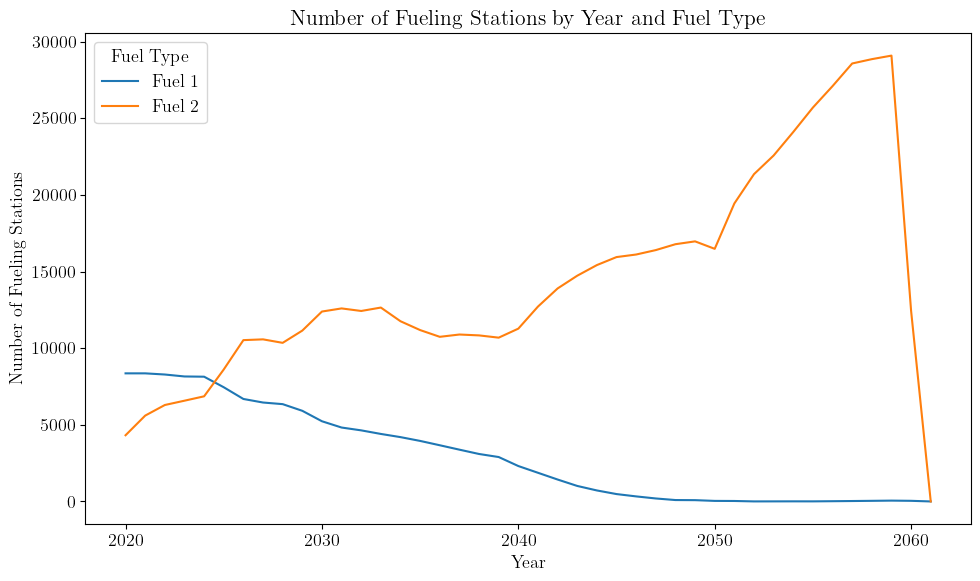

{(2045, 2): 15942.494254992522, (2023, 2): 6573.155395236824, (2024, 1): 8138.524901489826, (2033, 1): 4404.298191246537, (2026, 2): 10524.386947962983, (2020, 2): 4319.353663362106, (2043, 2): 14727.301277453711, (2043, 1): 1011.9258874582905, (2029, 1): 5913.507719609184, (2057, 2): 28572.186940764175, (2020, 1): 8356.929558425983, (2025, 1): 7450.131961747323, (2038, 2): 10832.901310843617, (2050, 2): 16480.55940031285, (2028, 2): 10347.104064565261, (2034, 2): 11756.453056983688, (2021, 2): 5600.889712683951, (2026, 1): 6685.520627580327, (2034, 1): 4196.606360287143, (2037, 2): 10890.465713433394, (2047, 1): 194.405514869081, (2039, 2): 10685.640759257514, (2022, 2): 6291.896072985579, (2053, 2): 22569.126771150743, (2059, 2): 29085.543633899288, (2022, 1): 8281.138841882226, (2031, 2): 12593.047029472664, (2058, 2): 28854.781469233345, (2047, 2): 16398.49234314856, (2049, 2): 16967.3381586265, (2037, 1): 3378.60500156798, (2035, 2): 11179.83533418901, (2051, 2): 19440.11864690601

In [294]:
print("n_fueling:", sum(n_fueling.values()))

# Aggregate n_fueling by year and fuel type
n_fueling_by_year_and_fuel = {}
for key, value in n_fueling.items():
    year = key[0]
    fuel = key[2][0]
    if (year, fuel) not in n_fueling_by_year_and_fuel:
        n_fueling_by_year_and_fuel[(year, fuel)] = 0
    n_fueling_by_year_and_fuel[(year, fuel)] += value

# Prepare data for plotting
fuel_types = list(set(fuel for _, fuel in n_fueling_by_year_and_fuel.keys()))
years = range(y_init, y_init+ Y + 1)
data = {fuel: [n_fueling_by_year_and_fuel.get((year, fuel), 0) for year in years] for fuel in fuel_types}
# Create the plot
fig, ax = plt.subplots(figsize=(10, 6))
for fuel, values in data.items():
    ax.plot(years, values, label=f"Fuel {fuel}")

ax.set_xlabel('Year')
ax.set_ylabel('Number of Fueling Stations')
ax.set_title('Number of Fueling Stations by Year and Fuel Type')
ax.legend(title='Fuel Type')
plt.tight_layout()
plt.show()
print(n_fueling_by_year_and_fuel)

In [295]:
print(sum(budget_penalty_minus.values()))
print(sum(budget_penalty_plus.values()))
print(sum(budget_penalty_plus_yearly.values()))
print(sum(budget_penalty_minus_yearly.values()))

0.0
0.0
3180986.181639
0.0


In [296]:
for key in f.keys():
    if key[0] == 2050 and f[key] > 0:
        print(key, f[key])

(2050, (1, 33, 7), (1, 3), 2041) 32.966179
(2050, (1, 51, 16), (1, 3), 2044) 313.152896
(2050, (1, 58, 16), (1, 3), 2047) 3175.967477
(2050, (1, 16, 0), (1, 3), 2041) 57.592932
(2050, (1, 50, 15), (1, 3), 2043) 5.533297
(2050, (1, 13, 0), (1, 1), 2047) 510.820415
(2050, (1, 52, 16), (1, 3), 2046) 506.545542
(2050, (1, 50, 15), (1, 5), 2041) 30.119303
(2050, (1, 28, 7), (1, 3), 2050) 1400.919402
(2050, (1, 7, 0), (1, 3), 2050) 521.909383
(2050, (1, 11, 0), (1, 3), 2050) 180.157017
(2050, (1, 46, 15), (1, 5), 2040) 35.660381
(2050, (1, 37, 7), (1, 3), 2040) 98.198036
(2050, (1, 52, 16), (1, 3), 2049) 527.463388
(2050, (1, 10, 0), (1, 3), 2040) 27.100987
(2050, (1, 27, 7), (1, 5), 2041) 438.486406
(2050, (1, 58, 16), (1, 3), 2048) 3218.92996
(2050, (1, 49, 14), (1, 5), 2045) 47.236408
(2050, (1, 45, 14), (1, 5), 2048) 61.302598
(2050, (1, 50, 15), (1, 3), 2040) 15.591319
(2050, (1, 37, 7), (1, 3), 2044) 380.568263
(2050, (1, 66, 16), (1, 3), 2046) 565.57278
(2050, (1, 54, 16), (1, 1), 204

In [297]:
vol = 0
for key in h.keys():
    if key[0] == 2050 and h[key] > 0:
        print(key, h[key])
        vol = vol + h[key]

print("Total volume:", vol)

(2050, 54, 1, 2049) 1399.132797
(2050, 32, 3, 2041) 12.613999
(2050, 44, 7, 2046) 1391.042346
(2050, 22, 3, 2047) 107.932238
(2050, 11, 3, 2042) 63.259397
(2050, 5, 3, 2049) 190.57845
(2050, 66, 3, 2043) 62.00055
(2050, 5, 1, 2039) 9.914943
(2050, 40, 1, 2045) 162.230484
(2050, 15, 5, 2042) 144.713293
(2050, 58, 3, 2046) 2864.435791
(2050, 56, 3, 2049) 1211.498704
(2050, 33, 3, 2050) 82.439059
(2050, 8, 1, 2047) 863.473803
(2050, 22, 3, 2048) 109.392278
(2050, 33, 3, 2046) 77.831769
(2050, 22, 5, 2042) 177.971409
(2050, 16, 3, 2048) 139.733606
(2050, 38, 5, 2043) 136.422864
(2050, 46, 5, 2040) 276.675367
(2050, 37, 3, 2042) 68.88691
(2050, 74, 5, 2049) 555.958594
(2050, 57, 3, 2040) 776.571938
(2050, 0, 3, 2041) 53.301617
(2050, 65, 1, 2049) 1685.861931
(2050, 12, 3, 2049) 253.836326
(2050, 22, 3, 2045) 104.977582
(2050, 50, 3, 2040) 120.967131
(2050, 73, 5, 2044) 455.159062
(2050, 22, 3, 2042) 20.463053
(2050, 23, 1, 2038) 102.630556
(2050, 17, 3, 2044) 206.959508
(2050, 29, 3, 2043) 

## Visualizations

- cummulative shift (vehicle stock after different types and technologies) (check!)
- shift by income class (check!)
- mode shift (check!)
- infrastructure expansion by year for each technology (check!)
- *impact of route length*

In [298]:
print(input_data.keys())
model_parameters = input_data["Model"]
print(model_parameters)

Y = model_parameters["Y"]
y_init = model_parameters["y_init"]
pre_y = model_parameters["pre_y"]

G = pre_y + Y
g_init = y_init - pre_y
Y_end = y_init + Y - 1


dict_keys(['DetourTimeReduction', 'Edge', 'FinancialStatus', 'Fuel', 'FuelingInfrTypes', 'GeographicElement', 'InitDetourTime', 'InitialFuelingInfr', 'InitialModeInfr', 'InitialVehicleStock', 'Initial_Mode_Share', 'Market_shares', 'MaximumFuelingCapacityByType', 'Mode', 'Model', 'Node', 'Odpair', 'Path', 'Product', 'Regiontype', 'Speed', 'TechVehicle', 'Technology', 'TripRatio', 'Vehicletype'])
{'E': 12, 'N': 2, 'Y': 41, 'budget_penalty_minus': 10000000, 'budget_penalty_plus': 10000000, 'budget_penalty_yearly_minus': 10000000, 'budget_penalty_yearly_plus': 10000000, 'discount_rate': 0.05, 'gamma': 0.0003, 'goals_no_new_ICEV': {2035: 0.0}, 'goals_tot_BEV': {2030: 230.0}, 'investment_period': 5, 'pre_y': 25, 'y_init': 2020}


In [299]:
# print(input_data.keys())
fuel_list = input_data["Fuel"]
mode_list = input_data["Mode"]
techvehicle_list = input_data["TechVehicle"]
odpair_list = input_data["Odpair"]  
financial_status_list = input_data["FinancialStatus"]

od_pair_list_by_year = {}
for y in range(y_init, Y_end + 1):

    od_pair_list_by_year[y] = sum(odpair_list[r]["F"][y - y_init] for r in range(0, len(odpair_list)))


fuel_list = {item["id"]: item for item in fuel_list}
fuel_infr_type_list = {item["id"]: item for item in input_data["FuelingInfrTypes"]}
mode_list = {item["id"]: item for item in mode_list}
techvehicle_list = {item["id"]: item for item in techvehicle_list}
odpair_list = {item["id"]: item for item in odpair_list}
financial_status_list = {item["id"]: item for item in financial_status_list}

# calculating for each technology and each year the total cost
def get_vehicle_stock(by_income_class = False, income_class=None):
    techveh_stock = {}

    for tv_id in techvehicle_list:

        for y in range(y_init, Y_end + 1):
            if not by_income_class:
                total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r, tv_id, g) in h.keys())
            else:
                total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r, tv_id, g) in h.keys())
            techveh_stock[(y, tv_id)] = total_veh_number
    return techveh_stock

In [300]:
# color palette defintion"
colors_techvehicles = ["#f7b267", "#76c893", "#c0b9dd", "#4f5d75", "#c9ada7", "#9a8c98", "#8e9aaf", "#8b8c89", "#463f3a", "#595959", "#604d53"]

In [301]:
print(sum(od_pair_list_by_year.values()))



20540513171.7473


In [302]:
veh_stock = get_vehicle_stock(True, "Commercial")
print(veh_stock)

{(2020, 0): 18529.146537, (2021, 0): 14110.546213, (2022, 0): 14920.921151, (2023, 0): 16615.785375, (2024, 0): 17064.771996, (2025, 0): 12958.152352000001, (2026, 0): 8424.597523, (2027, 0): 7748.445723, (2028, 0): 6622.714397, (2029, 0): 4948.707959, (2030, 0): 1131.24, (2031, 0): 1010.6424010000001, (2032, 0): 949.1800000000001, (2033, 0): 767.12, (2034, 0): 575.34, (2035, 0): 426.65785900000003, (2036, 0): 191.78, (2037, 0): 0.0, (2038, 0): 0.0, (2039, 0): 0.0, (2040, 0): 0.0, (2041, 0): 0.0, (2042, 0): 0.0, (2043, 0): 0.0, (2044, 0): 0.0, (2045, 0): 0.0, (2046, 0): 0.0, (2047, 0): 0.0, (2048, 0): 0.0, (2049, 0): 0.0, (2050, 0): 0.0, (2051, 0): 0.0, (2052, 0): 0.0, (2053, 0): 0.0, (2054, 0): 0.0, (2055, 0): 0.0, (2056, 0): 0.0, (2057, 0): 0.0, (2058, 0): 0.0, (2059, 0): 0.0, (2060, 0): 0.0, (2020, 1): 5425.509949, (2021, 1): 8684.175257, (2022, 1): 12409.166547, (2023, 1): 14835.246556, (2024, 1): 15975.15266, (2025, 1): 20689.34084, (2026, 1): 25408.932009, (2027, 1): 26127.429886

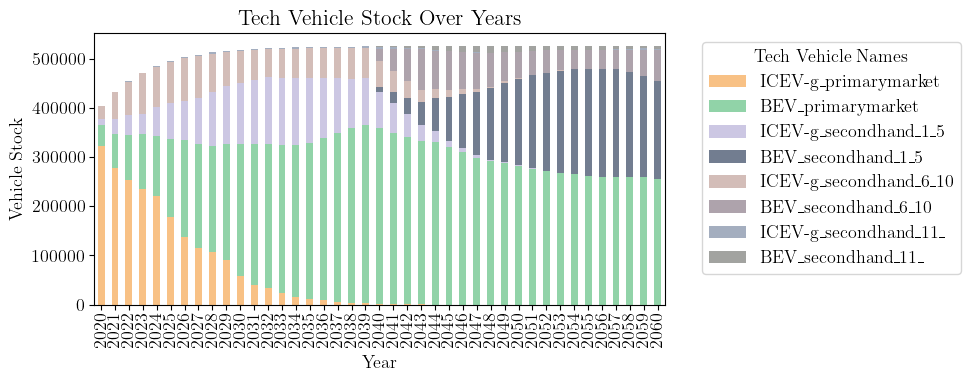

{2020: [321735.219926,
  44357.07535,
  11222.713948,
  0.0,
  26614.761795,
  0.0,
  285.137137,
  0.0],
 2021: [277025.665282,
  70557.42735,
  29259.380412,
  0.0,
  54749.325013,
  0.0,
  705.034294,
  0.0],
 2022: [252620.618986,
  92935.928107,
  40879.878553,
  0.0,
  66930.112489,
  0.0,
  1164.3815160000001,
  0.0],
 2023: [235122.272382,
  110969.42271299999,
  41119.343268,
  0.0,
  83120.328686,
  0.0,
  1506.6167050000001,
  0.0],
 2024: [221775.742541,
  121759.161907,
  58105.619841,
  0.0,
  81755.532007,
  0.0,
  1742.6608310000001,
  0.0],
 2025: [178089.579871,
  158605.833997,
  73470.074345,
  0.0,
  83133.065469,
  0.0,
  1964.6111460000002,
  0.0],
 2026: [137298.452001,
  198324.101241,
  79055.358391,
  0.0,
  86079.946859,
  0.0,
  2157.115881,
  0.0],
 2027: [115455.120795,
  210864.791538,
  94236.372308,
  0.0,
  85775.73744,
  0.0,
  2335.30369,
  0.0],
 2028: [107323.158675,
  215385.602188,
  109438.47852,
  0.0,
  78397.262609,
  0.0,
  2430.14637500000

In [303]:
tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
fig, ax = plt.subplots(figsize=(10, 4))

years = range(y_init, Y_end + 1)
tech_ids = list(techvehicle_list.keys())

techveh_stock_all = get_vehicle_stock()

# Prepare data for stacked bar plot
data = {year: [techveh_stock_all.get((year, tech_id), 0) for tech_id in tech_ids] for year in years}
df = pd.DataFrame(data, index=tech_ids).T

# Plotting
bars = df.plot(kind='bar', stacked=True, ax=ax, color=colors_techvehicles, alpha=0.8)
ax.set_xlabel('Year')
ax.set_ylabel('Vehicle Stock')
ax.set_title('Tech Vehicle Stock Over Years')

handles, _ = ax.get_legend_handles_labels()
ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')
 # plt.legend(title='Tech Vehicle ID', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

data

2020 0 78653.57823
2021 0 102935.862438
2022 0 94993.519298
2023 0 95658.224902
2024 0 87004.305116
2025 0 84789.898743
2026 0 83600.384684
2027 0 90002.191357
2028 0 89926.609678
2029 0 86807.690653
2030 0 88782.754294
2031 0 91780.450871
2032 0 93608.341102
2033 0 93173.186243
2034 0 96011.359451
2035 0 93829.936996
2036 0 92537.507325
2037 0 93753.306648
2038 0 94659.960979
2039 0 99436.498854
2040 0 116174.275022
2041 0 113194.939665
2042 0 113983.702146
2043 0 114320.778363
2044 0 107982.088363
2045 0 107185.183787
2046 0 108961.236285
2047 0 108917.104551
2048 0 108737.528653
2049 0 109244.929477
2050 0 110623.256354
2051 0 110361.386774
2052 0 110086.177963
2053 0 86397.845531
2054 0 108624.364308
2055 0 114047.968425
2056 0 86900.625874
2057 0 107115.8523
2058 0 115086.757852
2059 0 91080.737489
2060 0 112203.166467
2020 1 17772.16
2021 1 62293.387639
2022 1 87860.531173
2023 1 94993.519298
2024 1 89576.166275
2025 1 87004.305116
2026 1 84789.898743
2027 1 83600.384684
2028 1 9

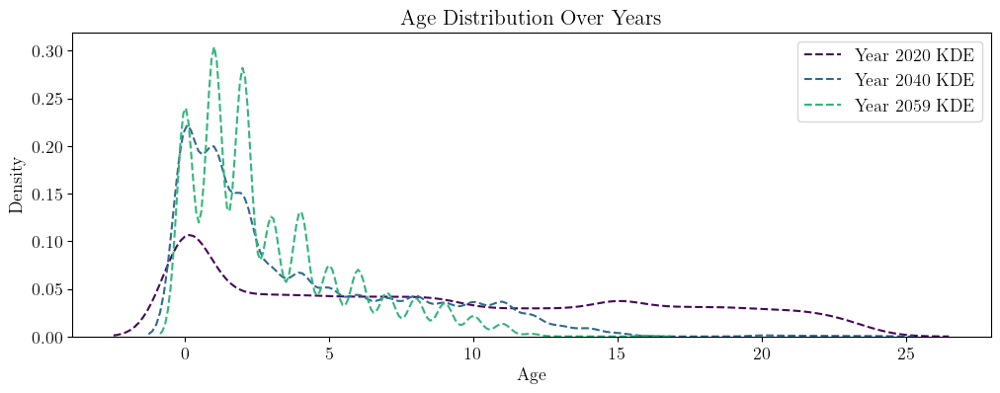

In [304]:
import scipy.stats as stats
import seaborn as sns
# If running in a Jupyter notebook, use the following to install packages:

# determining technology share in each year + age strucuture
age_distribution_per_year = {}
ages = []
for y in range(y_init, Y_end + 1):
    total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    for g in range(g_init, y+1):
        curr_veh_nb = sum(h[(y, r, tv_id, g)] for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        age = y - g
        if (y, age) in age_distribution_per_year.keys():
            age_distribution_per_year[(y, age)] += curr_veh_nb
        else:
            age_distribution_per_year[(y, age)] = curr_veh_nb
        ages.append(age)

for age in range(0, max(ages)):
    for y in range(y_init, Y_end + 1):
        if (y, age) not in age_distribution_per_year.keys():
            age_distribution_per_year[(y, age)] = 0
        print(y, age, age_distribution_per_year[(y, age)])

# Create a list of hex codes with different colors
print(age_distribution_per_year)
color_palette = sns.color_palette("viridis", 60).as_hex()
fig, ax = plt.subplots(figsize=(12, 4))
for y in range(y_init, Y_end + 1):
    if y in [2020, 2040, 2059]:
        # Create a DataFrame for the current year
        age_distribution_per_year[y] = {age: age_distribution_per_year[(y, age)] for age in range(0, max(ages)) if (y, age) in age_distribution_per_year.keys()}
        curr_distribution = age_distribution_per_year[y]

        df = pd.DataFrame(list(curr_distribution.items()), columns=["Age", "Count"])
        df = df.apply(pd.to_numeric, errors="coerce")  # Convert to numbers, set invalid to NaN
        df.dropna(inplace=True)  # Drop NaN values
        # Expand data by repeating ages according to their counts
        expanded_ages = np.repeat(df["Age"], df["Count"])

        # Fit a Normal Distribution
        mu, sigma = stats.norm.fit(expanded_ages)

        # Generate x values for PDF
        x = np.linspace(min(df["Age"]), max(df["Age"]), 100)
        pdf = stats.norm.pdf(x, mu, sigma)

        # Plot KDE & Normal Fit
        sns.kdeplot(expanded_ages, bw_adjust=1.5, label=f"Year {y} KDE", linestyle="dashed", color=color_palette[y - y_init])
        # plt.plot(x, pdf, label=f"Year {y} Fit (μ={mu:.1f}, σ={sigma:.1f})", color=color_palette[y - y_init])

# Formatting the plot
plt.title("Age Distribution Over Years")
plt.xlabel("Age")
plt.ylabel("Density")
plt.legend()

plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_age_distribution.png"), transparent=True)
for y in range(y_init, Y_end + 1):
    for age in range(0, max(ages)):
        print(y, age, age_distribution_per_year[(y, age)])
    

2020 2060


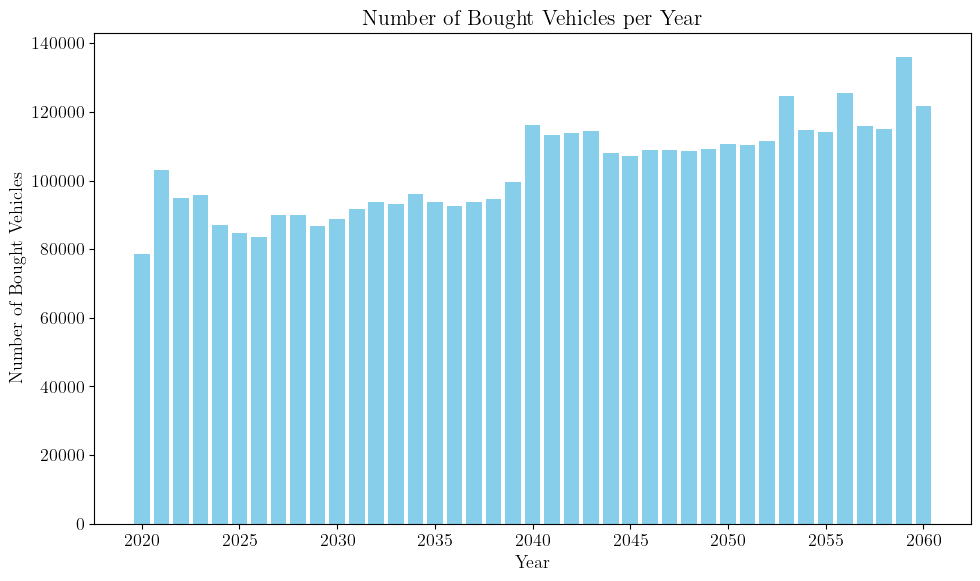

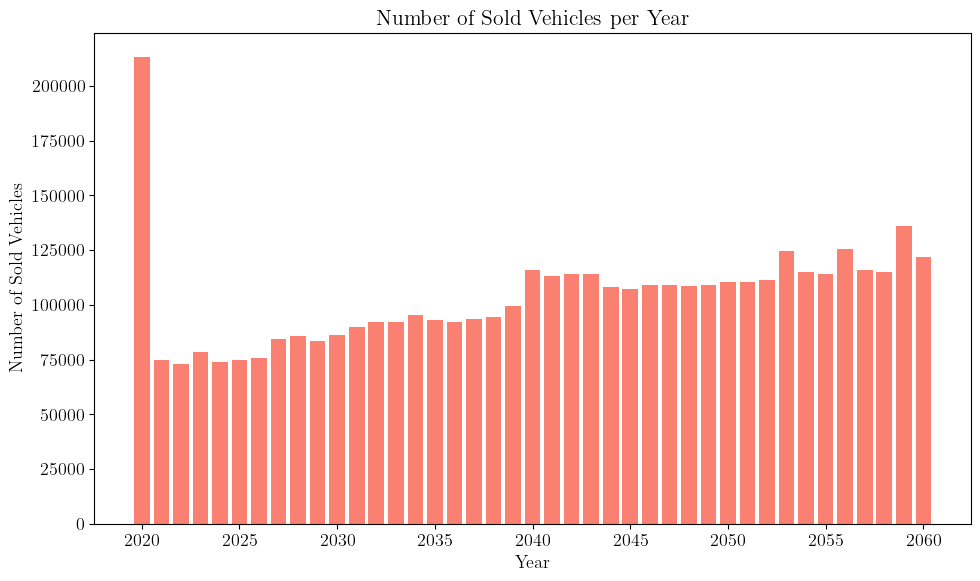

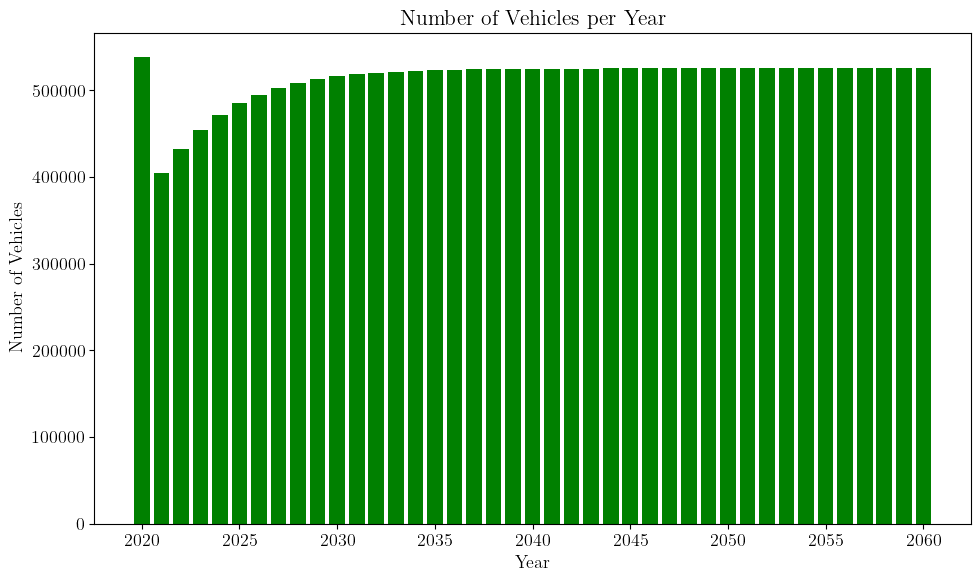

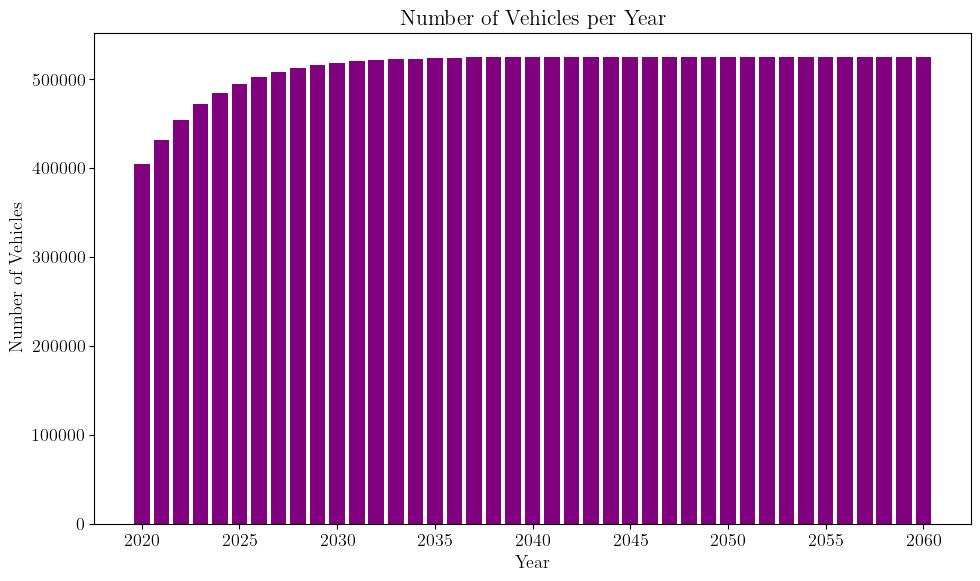

In [305]:
# ANALYSIS OF BOUGHT AND SOLD VEHICLES 
bought_vehicles = {}
exiting_vehicles = {}
h_now = {}
h_all = {}
print(y_init, Y_end)
for y in range(y_init, Y_end + 1):
    total_veh_number = sum(h_plus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    bought_vehicles[y] = total_veh_number
    total_veh_number = sum(h_minus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    exiting_vehicles[y] = total_veh_number
    total_veh_number = sum(h_exist[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    h_now[y] = total_veh_number
    total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
    h_all[y] = total_veh_number

fig, ax = plt.subplots(figsize=(10, 6))

years = range(y_init, Y_end + 1)
bought_values = [bought_vehicles[year] for year in years]

ax.bar(years, bought_values, color='skyblue')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Bought Vehicles')
ax.set_title('Number of Bought Vehicles per Year')

plt.tight_layout()
plt.show()

sold_values = [exiting_vehicles[year] for year in years]

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(years, sold_values, color='salmon')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Sold Vehicles')
ax.set_title('Number of Sold Vehicles per Year')

plt.tight_layout()
plt.show()

h_now_values = [h_now[year] for year in years]

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(years, h_now_values, color='green')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Vehicles')
ax.set_title('Number of Vehicles per Year')
plt.tight_layout()
plt.show()

h_all_values = [h_all[year] for year in years]

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(years, h_all_values, color='purple')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Vehicles')
ax.set_title('Number of Vehicles per Year')
plt.tight_layout()
plt.show()

{(2058, 26): 0.0, (2041, 64): 0.0, (2032, 20): 0.0, (2046, 21): 0.0, (2059, 36): 0.0, (2048, 43): 0.0, (2031, 57): 0.0, (2036, 13): 0.0, (2051, 58): 0.0, (2046, 13): 0.0, (2044, 57): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2059, 1): 0.0, (2058, 53): 0.0, (2039, 43): 0.0, (2046, 46): 0.0, (2030, 37): 0.0, (2049, 29): 0.0, (2046, 53): 0.0, (2025, 70): 0.0, (2031, 73): 0.0, (2052, 5): 0.0, (2042, 18): 0.0, (2022, 6): 0.0, (2045, 40): 0.0, (2060, 44): 0.0, (2046, 64): 0.0, (2025, 20): 0.0, (2053, 63): 0.0, (2058, 52): 0.0, (2028, 17): 0.0, (2030, 36): 0.0, (2029, 15): 0.0, (2041, 65): 0.0, (2043, 51): 0.0, (2021, 52): 0.0, (2041, 38): 0.0, (2028, 37): 0.0, (2029, 60): 0.0, (2047, 60): 0.0, (2036, 69): 0.0, (2039, 73): 0.0, (2034, 30): 0.0, (2030, 15): 0.0, (2027, 30): 0.0, (2032, 35): 0.0, (2054, 68): 0.0, (2048, 37): 0.0, (2031, 30): 0.0, (2037, 69): 0.0, (2053, 37): 0.0, (2025, 33): 0.0, (2030, 39): 0.0, (2024, 35): 0.0, (2032, 63): 0.0, (2021, 69): 0.0, (2020, 0): 0.0, 

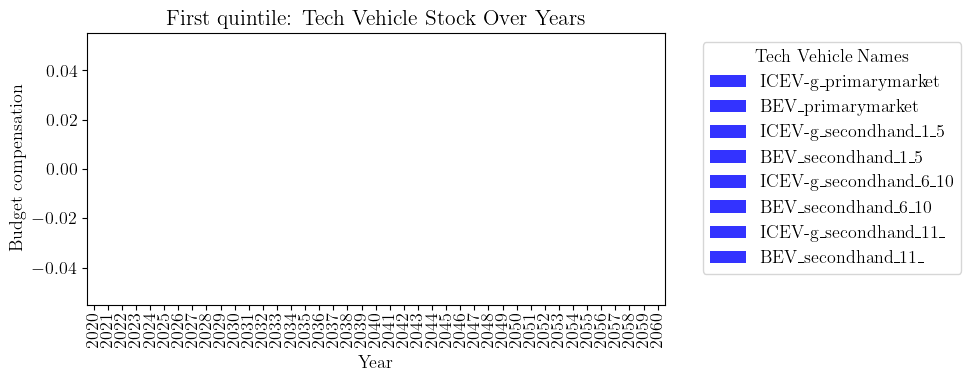

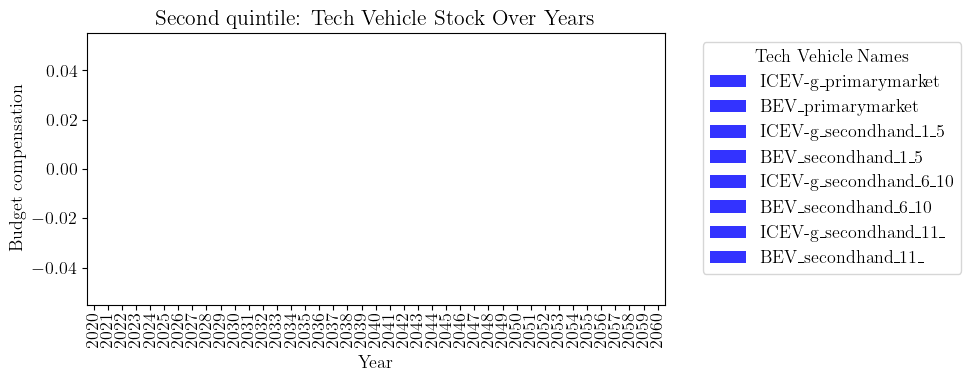

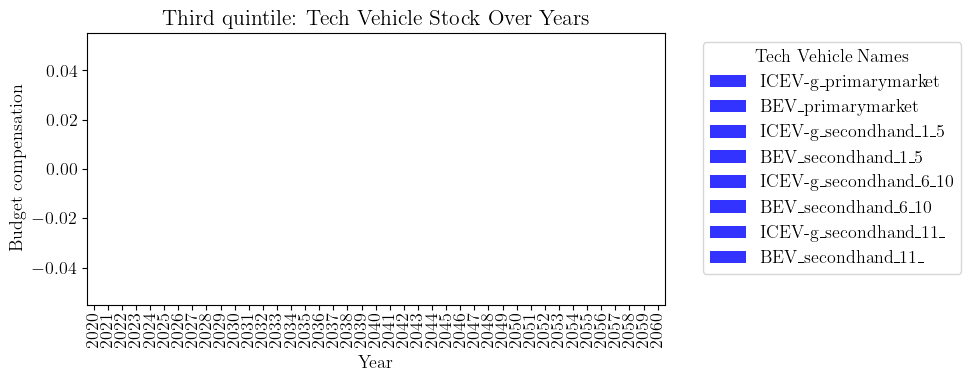

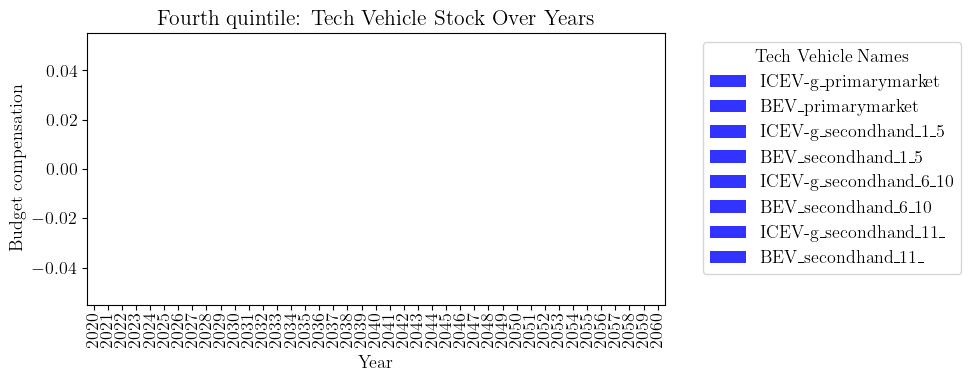

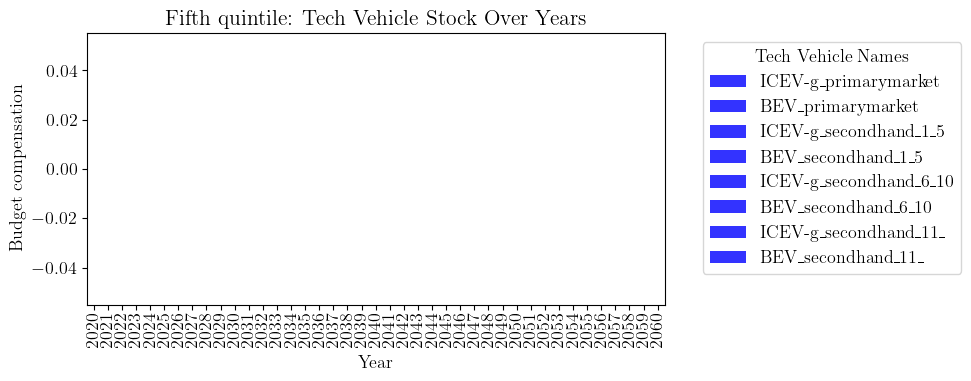

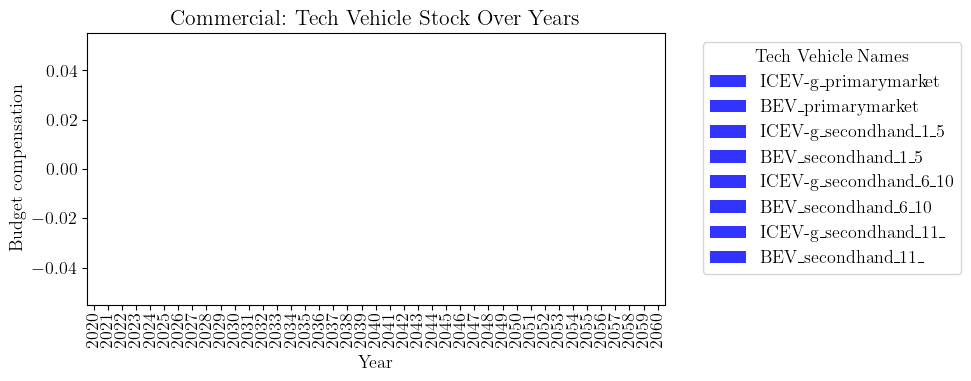

In [306]:
# looking a budget penalties
def get_budget_penalty_total(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


{(2058, 26): 0.0, (2041, 64): 0.0, (2032, 20): 0.0, (2046, 21): 0.0, (2059, 36): 0.0, (2048, 43): 0.0, (2031, 57): 0.0, (2036, 13): 0.0, (2051, 58): 0.0, (2046, 13): 0.0, (2044, 57): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2059, 1): 0.0, (2058, 53): 0.0, (2039, 43): 0.0, (2046, 46): 0.0, (2030, 37): 0.0, (2049, 29): 0.0, (2046, 53): 0.0, (2025, 70): 0.0, (2031, 73): 0.0, (2052, 5): 0.0, (2042, 18): 0.0, (2022, 6): 0.0, (2045, 40): 0.0, (2060, 44): 0.0, (2046, 64): 0.0, (2025, 20): 0.0, (2053, 63): 0.0, (2058, 52): 0.0, (2028, 17): 0.0, (2030, 36): 0.0, (2029, 15): 0.0, (2041, 65): 0.0, (2043, 51): 0.0, (2021, 52): 0.0, (2041, 38): 0.0, (2028, 37): 0.0, (2029, 60): 0.0, (2047, 60): 0.0, (2036, 69): 0.0, (2039, 73): 0.0, (2034, 30): 0.0, (2030, 15): 0.0, (2027, 30): 0.0, (2032, 35): 0.0, (2054, 68): 0.0, (2048, 37): 0.0, (2031, 30): 0.0, (2037, 69): 0.0, (2053, 37): 0.0, (2025, 33): 0.0, (2030, 39): 0.0, (2024, 35): 0.0, (2032, 63): 0.0, (2021, 69): 0.0, (2020, 0): 0.0, 

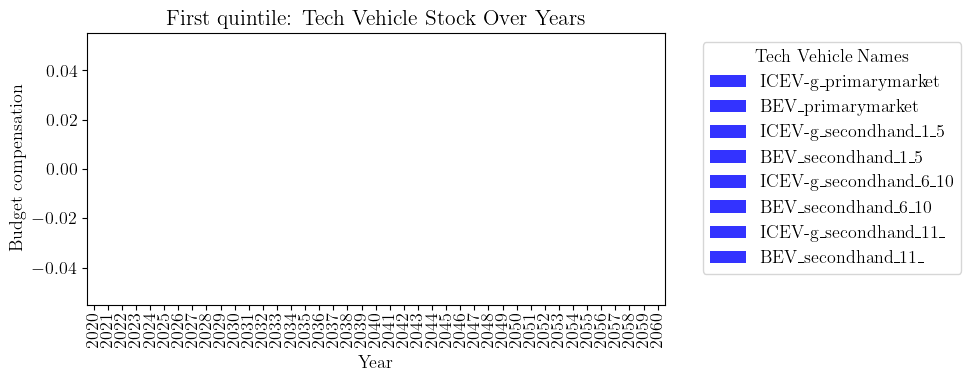

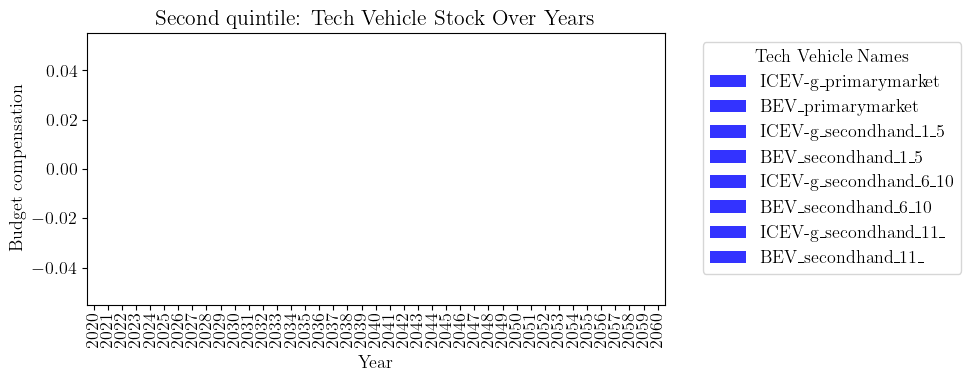

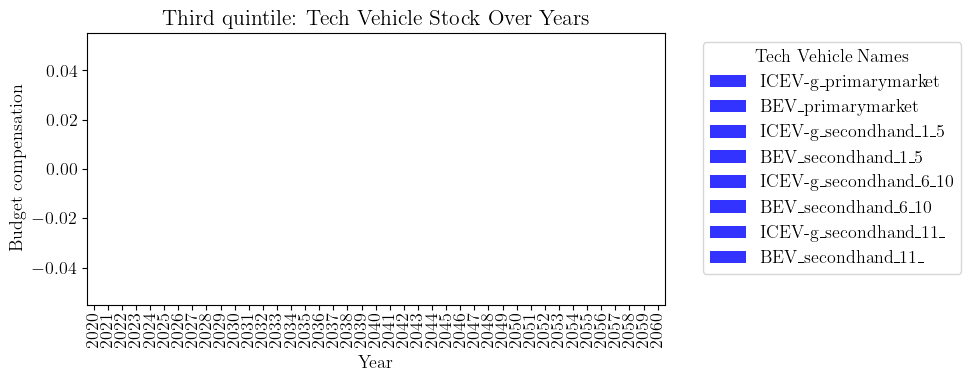

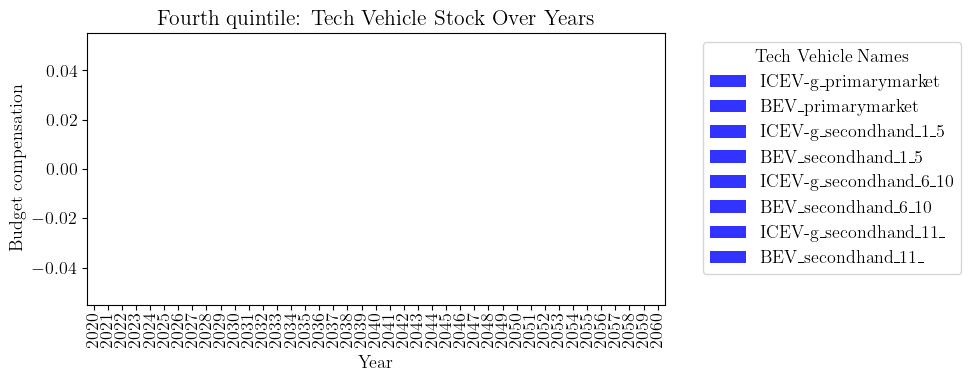

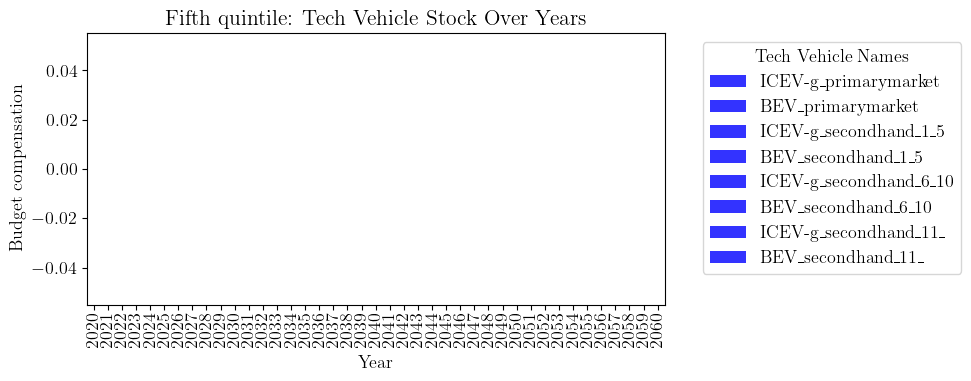

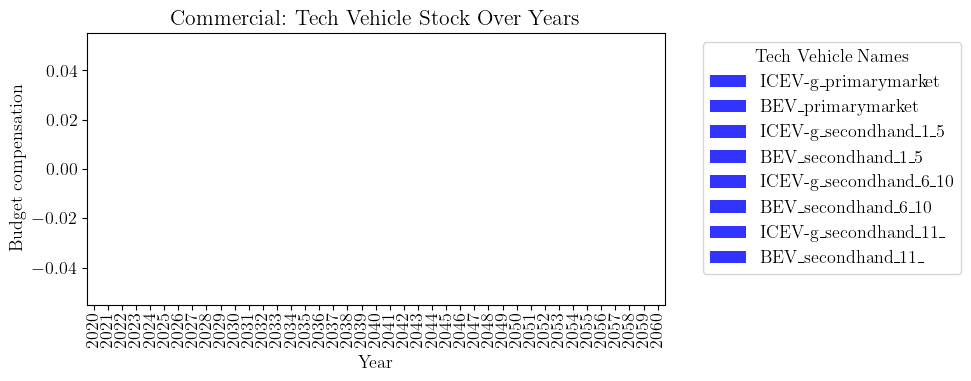

In [307]:
# looking a budget penalties
def get_budget_penalty_total(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


{(2058, 26): 0.0, (2041, 64): 0.0, (2032, 20): 0.0, (2046, 21): 0.0, (2059, 36): 0.0, (2048, 43): 0.0, (2031, 57): 0.0, (2036, 13): 0.0, (2051, 58): 0.0, (2046, 13): 0.0, (2044, 57): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2059, 1): 0.0, (2058, 53): 0.0, (2039, 43): 0.0, (2046, 46): 0.0, (2030, 37): 0.0, (2049, 29): 0.0, (2046, 53): 0.0, (2025, 70): 0.0, (2031, 73): 0.0, (2052, 5): 0.0, (2042, 18): 0.0, (2022, 6): 0.0, (2045, 40): 0.0, (2060, 44): 0.0, (2046, 64): 0.0, (2025, 20): 0.0, (2053, 63): 0.0, (2058, 52): 0.0, (2028, 17): 0.0, (2030, 36): 0.0, (2029, 15): 0.0, (2041, 65): 0.0, (2043, 51): 0.0, (2021, 52): 0.0, (2041, 38): 0.0, (2028, 37): 0.0, (2029, 60): 0.0, (2047, 60): 0.0, (2036, 69): 0.0, (2039, 73): 0.0, (2034, 30): 0.0, (2030, 15): 0.0, (2027, 30): 0.0, (2032, 35): 0.0, (2054, 68): 0.0, (2048, 37): 0.0, (2031, 30): 0.0, (2037, 69): 0.0, (2053, 37): 0.0, (2025, 33): 0.0, (2030, 39): 0.0, (2024, 35): 0.0, (2032, 63): 0.0, (2021, 69): 0.0, (2020, 0): 0.0, 

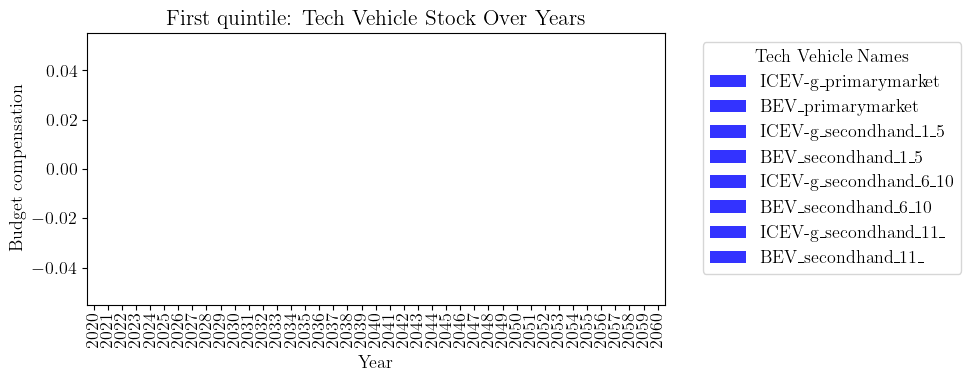

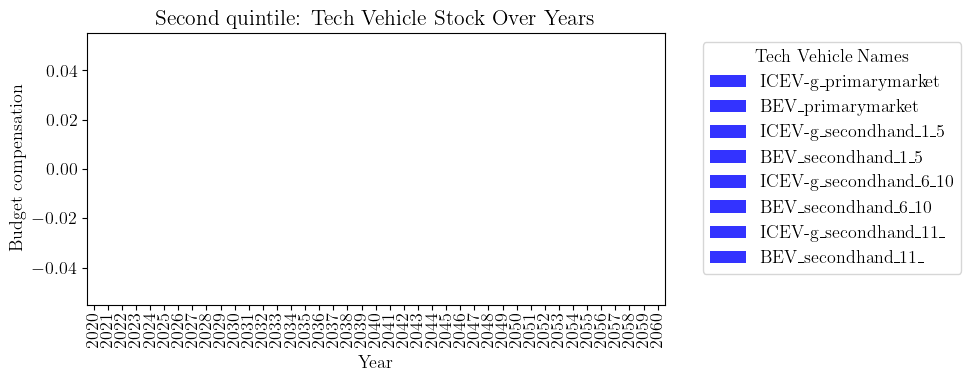

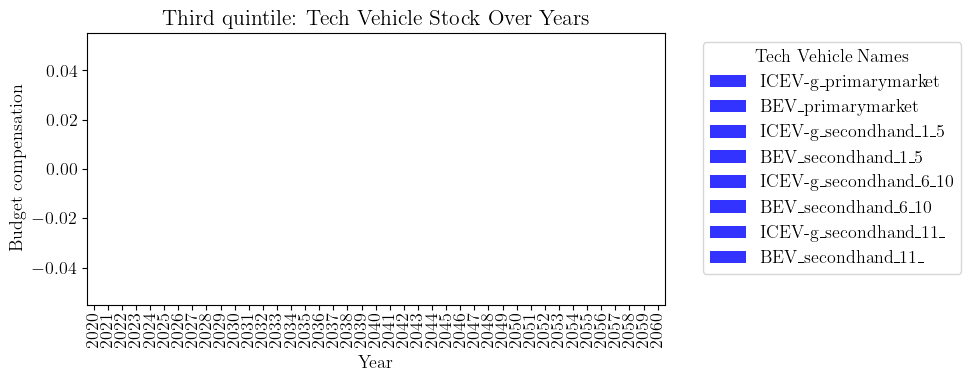

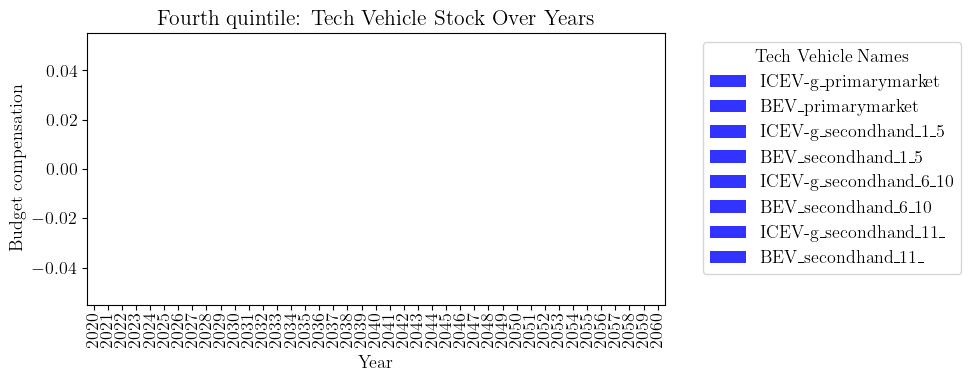

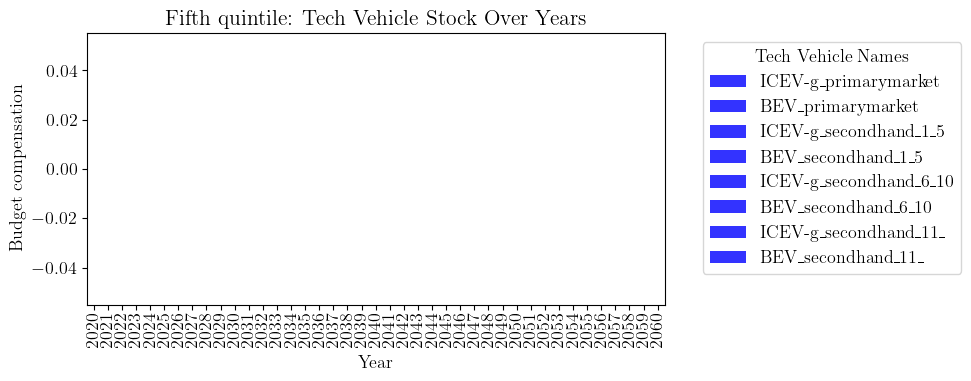

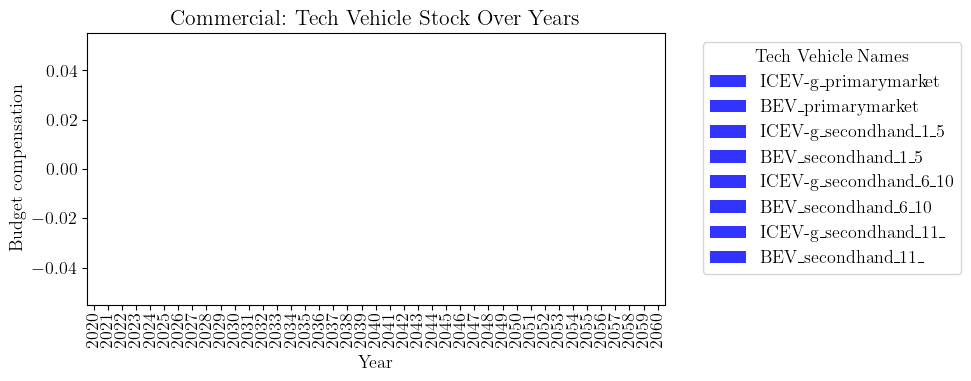

In [308]:
# looking a budget penalties
def get_budget_penalty_total(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


In [309]:
print(f.keys())

dict_keys([(2048, (1, 51, 16), (1, 3), 2026), (2058, (1, 20, 0), (1, 3), 2039), (2040, (1, 46, 15), (1, 4), 2017), (2042, (1, 51, 16), (1, 2), 2037), (2059, (1, 67, 16), (1, 1), 2009), (2052, (1, 62, 16), (1, 0), 2024), (2052, (1, 2, 0), (1, 0), 1995), (2040, (1, 17, 0), (1, 5), 2018), (2020, (1, 15, 0), (1, 4), 2015), (2048, (1, 44, 14), (1, 3), 2037), (2052, (1, 58, 16), (1, 3), 1995), (2035, (1, 48, 15), (1, 2), 2030), (2039, (1, 70, 16), (1, 5), 2033), (2027, (1, 1, 0), (1, 3), 2000), (2045, (1, 49, 14), (1, 4), 2027), (2026, (1, 26, 7), (1, 5), 2020), (2047, (1, 34, 7), (1, 3), 2023), (2021, (1, 35, 7), (1, 1), 2014), (2050, (1, 33, 7), (1, 3), 2041), (2053, (1, 7, 0), (1, 1), 2046), (2020, (1, 53, 16), (1, 4), 2008), (2043, (1, 70, 16), (1, 4), 2039), (2040, (1, 23, 7), (1, 0), 2030), (2058, (1, 25, 7), (1, 3), 2052), (2020, (1, 39, 7), (1, 6), 2020), (2020, (1, 59, 16), (1, 7), 2003), (2045, (1, 70, 16), (1, 6), 2038), (2025, (1, 33, 7), (1, 2), 2010), (2043, (1, 33, 7), (1, 1),

2020 2060


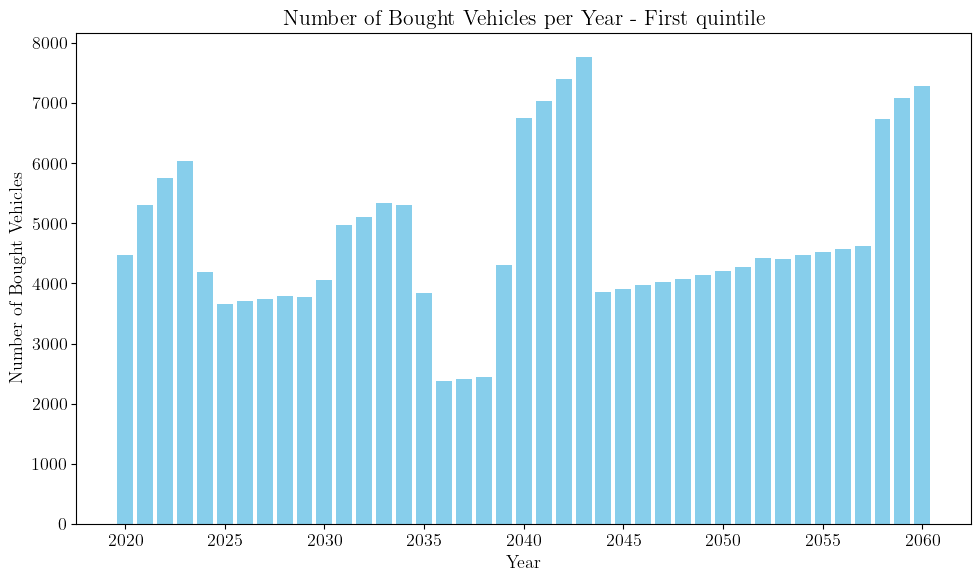

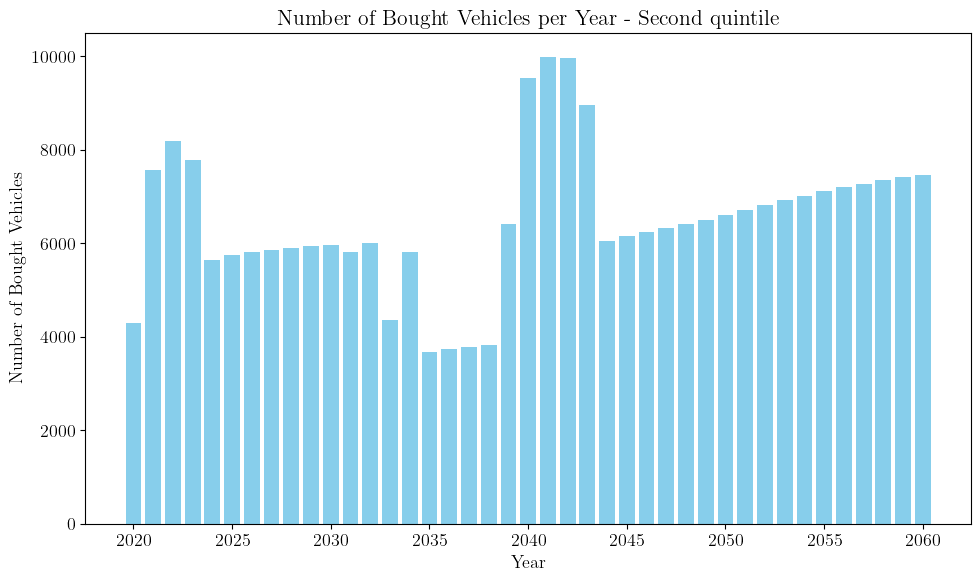

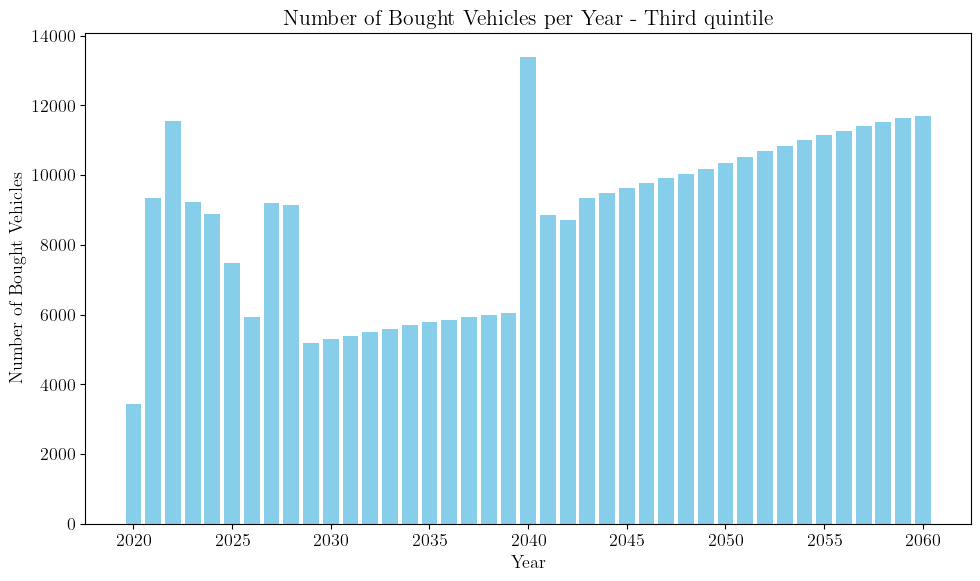

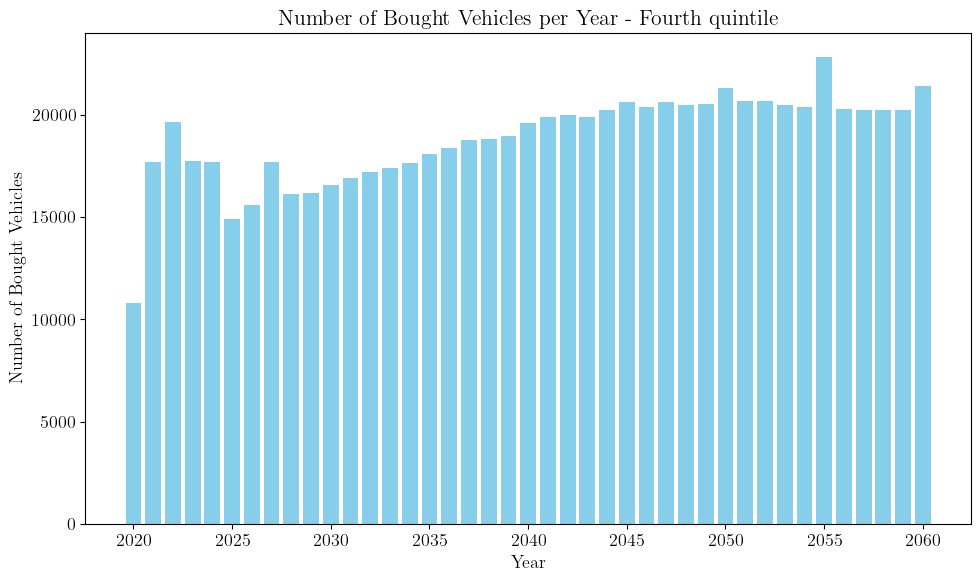

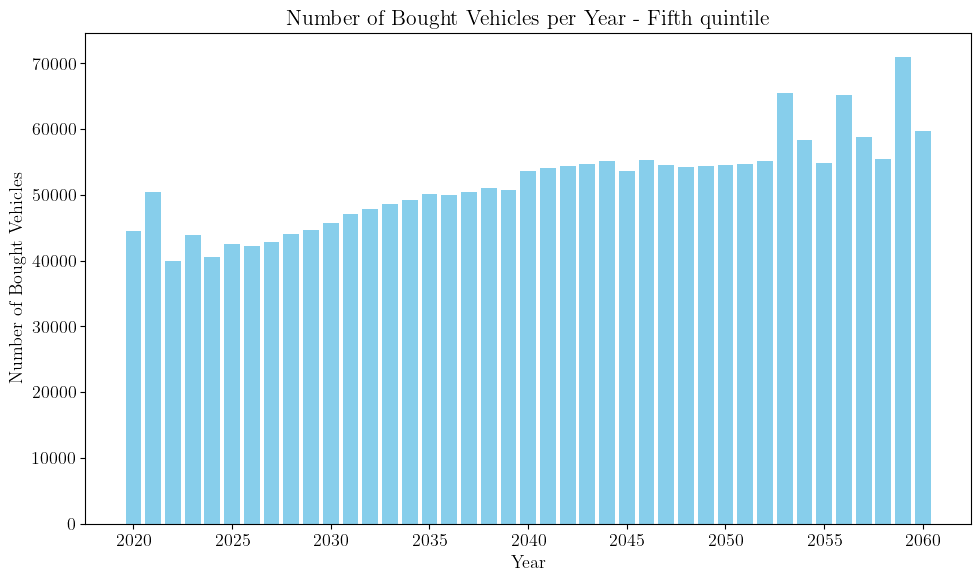

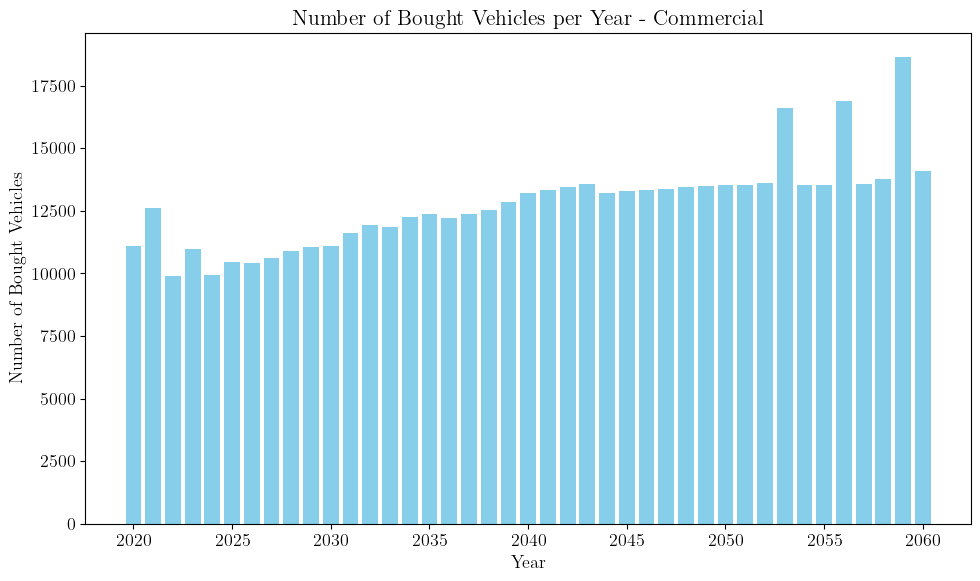

In [310]:
# purchases by income class
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}


print(y_init, Y_end)
for fin in financial_status_list.keys():
    bought_vehicles = {}
    exiting_vehicles = {}
    h_now = {}
    h_all = {}
    income_class = financial_status_list[fin]["name"]
    for y in range(y_init, Y_end + 1):
        total_veh_number = sum(h_plus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r, tv_id, g) in h.keys())
        bought_vehicles[y] = total_veh_number
        total_veh_number = sum(h_minus[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        exiting_vehicles[y] = total_veh_number
        total_veh_number = sum(h_exist[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        h_now[y] = total_veh_number
        total_veh_number = sum(h[(y, r, tv_id, g)] for g in range(g_init, y + 1) for r in odpair_list.keys() for tv_id in techvehicle_list.keys() if (y, r, tv_id, g) in h.keys())
        h_all[y] = total_veh_number

    fig, ax = plt.subplots(figsize=(10, 6))

    years = range(y_init, Y_end + 1)
    bought_values = [bought_vehicles[year] for year in years]

    ax.bar(years, bought_values, color='skyblue')
    ax.set_xlabel('Year')
    ax.set_ylabel('Number of Bought Vehicles')
    ax.set_title('Number of Bought Vehicles per Year - ' + income_class)

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_bought_vehicles_" + income_class + ".png"), transparent=True)

In [311]:
tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]

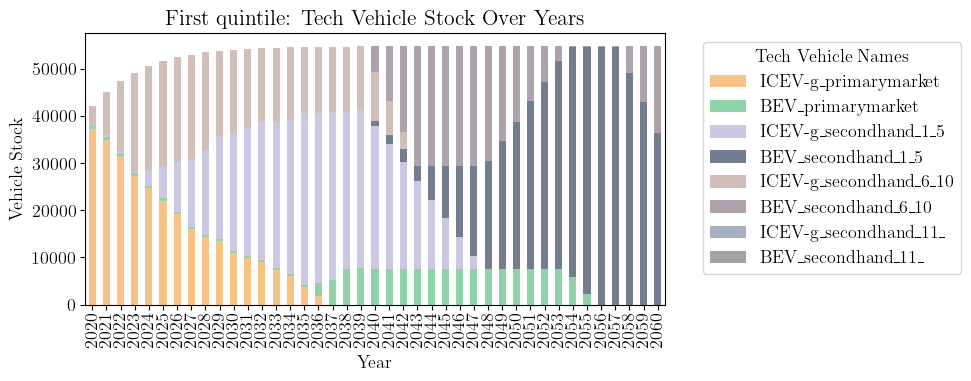

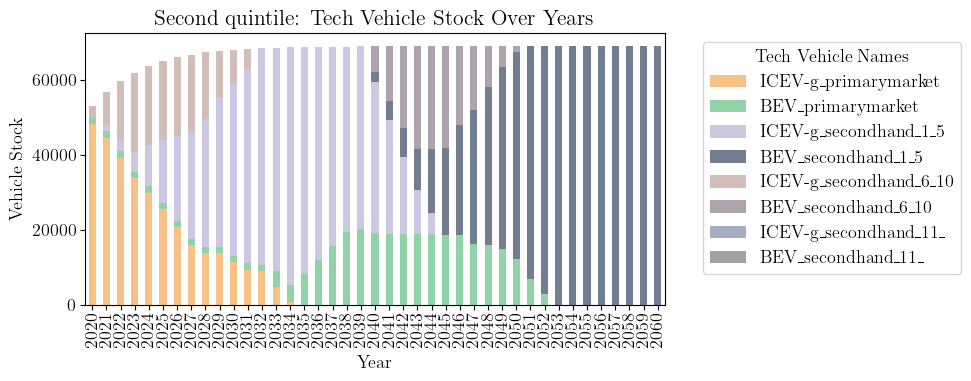

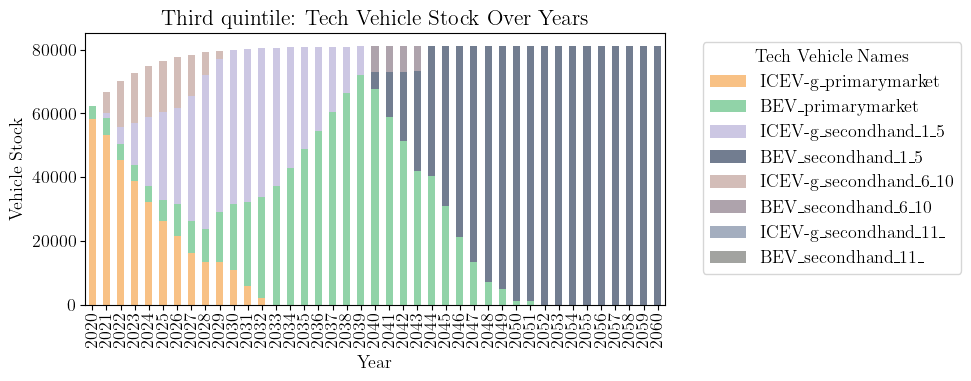

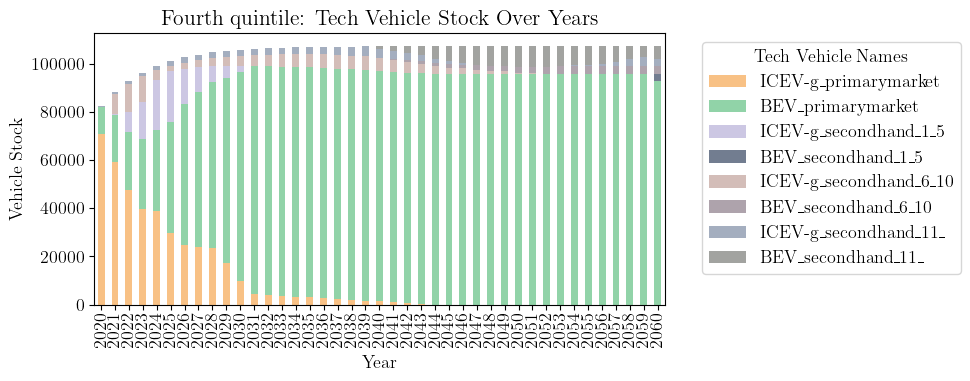

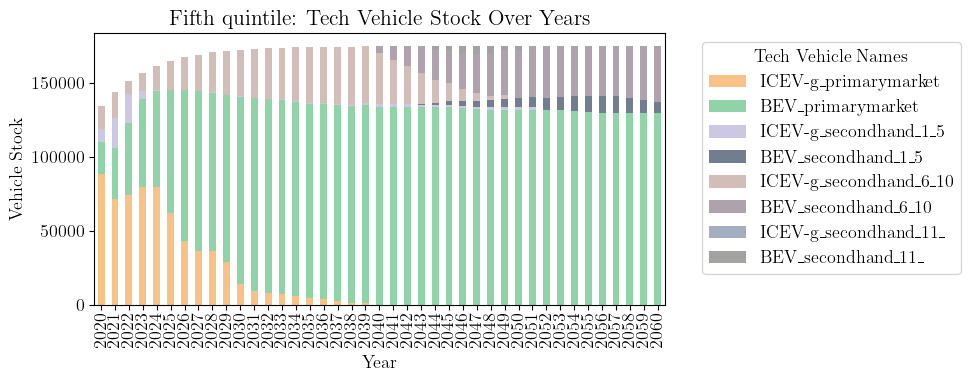

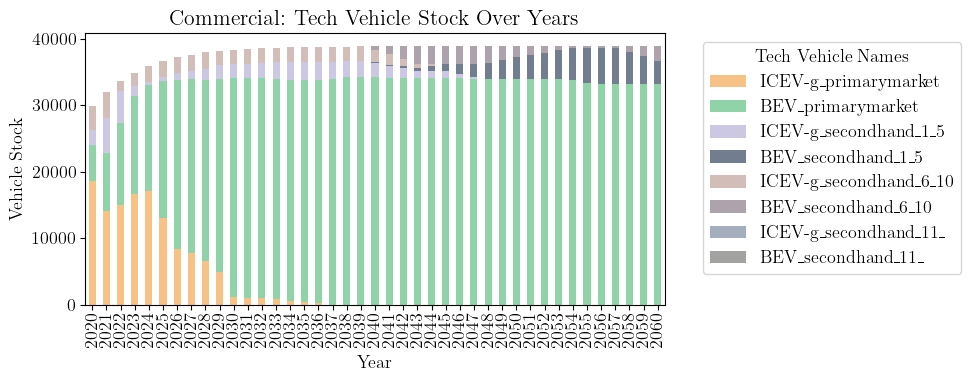

In [312]:
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_vehicle_stock(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year, tech_id), 0) for tech_id in tech_ids] for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color=colors_techvehicles, alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Vehicle Stock')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)


In [313]:
# looking a budget penalties
# def get_budget_penalty_total(by_income_class = False, income_class=None):
#     budget_pen = {}

#     # for tv_id in techvehicle_list:

#     for y in range(y_init, Y_end + 1):
#         if not by_income_class:
#             total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
#         else:
#             total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
#         budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
#     return budget_pen

# financial_status_list = input_data["FinancialStatus"]
# financial_status_list = {item["id"]: item for item in financial_status_list}
# for fin in financial_status_list.keys():
#     tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
#     fig, ax = plt.subplots(figsize=(10, 4))

#     years = range(y_init, Y_end + 1)
#     tech_ids = list(techvehicle_list.keys())

#     techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

#     # Prepare data for stacked bar plot
    
#     data = {year: [techveh_stock_all.get((year))]for year in years}
#     df = pd.DataFrame(data, index=tech_ids).T

#     # Plotting
#     bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
#     ax.set_xlabel('Year')
#     ax.set_ylabel('Budget compensation')
#     ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
#     handles, _ = ax.get_legend_handles_labels()
#     ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

#     plt.tight_layout()
#     plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
# print(budget_penalty_plus)

In [314]:
# looking a budget penalties
# def get_budget_penalty_total_yearly(by_income_class = False, income_class=None):
#     budget_pen = {}

#     # for tv_id in techvehicle_list:

#     for y in range(y_init, Y_end + 1):
#         if not by_income_class:
#             total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
#         else:
#             total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
#             total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
#         budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
#     return budget_pen

# financial_status_list = input_data["FinancialStatus"]
# financial_status_list = {item["id"]: item for item in financial_status_list}
# for fin in financial_status_list.keys():
#     tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
#     fig, ax = plt.subplots(figsize=(10, 4))

#     years = range(y_init, Y_end + 1)
#     tech_ids = list(techvehicle_list.keys())

#     techveh_stock_all = get_budget_penalty_total_yearly(by_income_class=True, income_class=financial_status_list[fin]["name"])

#     # Prepare data for stacked bar plot
    
#     data = {year: [techveh_stock_all.get((year))]for year in years}
#     df = pd.DataFrame(data, index=tech_ids).T

#     # Plotting
#     bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
#     ax.set_xlabel('Year')
#     ax.set_ylabel('Budget compensation')
#     ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
#     handles, _ = ax.get_legend_handles_labels()
#     ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

#     plt.tight_layout()
#     plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
# print(budget_penalty_plus)

{(2058, 26): 0.0, (2041, 64): 0.0, (2032, 20): 0.0, (2046, 21): 0.0, (2059, 36): 0.0, (2048, 43): 0.0, (2031, 57): 0.0, (2036, 13): 0.0, (2051, 58): 0.0, (2046, 13): 0.0, (2044, 57): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2059, 1): 0.0, (2058, 53): 0.0, (2039, 43): 0.0, (2046, 46): 0.0, (2030, 37): 0.0, (2049, 29): 0.0, (2046, 53): 0.0, (2025, 70): 0.0, (2031, 73): 0.0, (2052, 5): 0.0, (2042, 18): 0.0, (2022, 6): 0.0, (2045, 40): 0.0, (2060, 44): 0.0, (2046, 64): 0.0, (2025, 20): 0.0, (2053, 63): 0.0, (2058, 52): 0.0, (2028, 17): 0.0, (2030, 36): 0.0, (2029, 15): 0.0, (2041, 65): 0.0, (2043, 51): 0.0, (2021, 52): 0.0, (2041, 38): 0.0, (2028, 37): 0.0, (2029, 60): 0.0, (2047, 60): 0.0, (2036, 69): 0.0, (2039, 73): 0.0, (2034, 30): 0.0, (2030, 15): 0.0, (2027, 30): 0.0, (2032, 35): 0.0, (2054, 68): 0.0, (2048, 37): 0.0, (2031, 30): 0.0, (2037, 69): 0.0, (2053, 37): 0.0, (2025, 33): 0.0, (2030, 39): 0.0, (2024, 35): 0.0, (2032, 63): 0.0, (2021, 69): 0.0, (2020, 0): 0.0, 

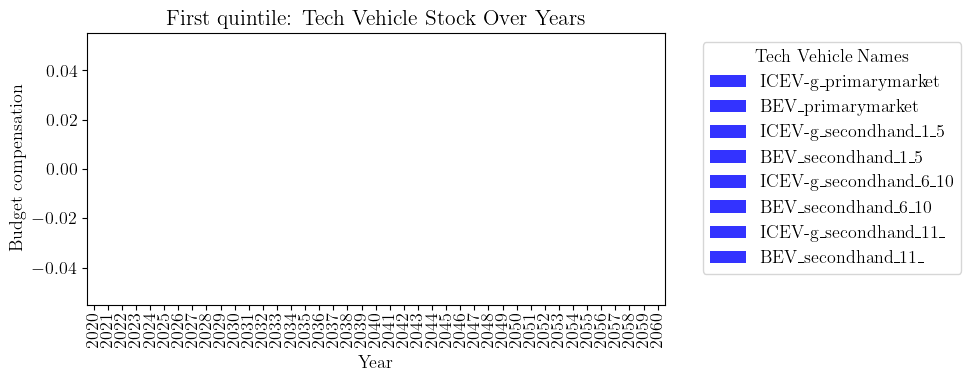

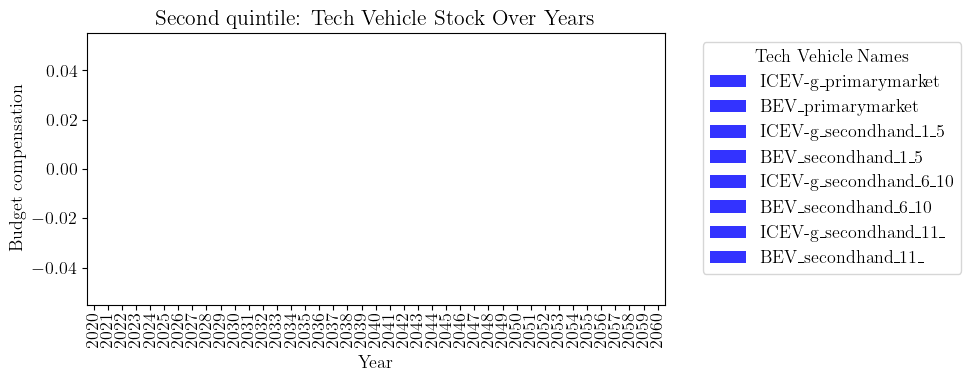

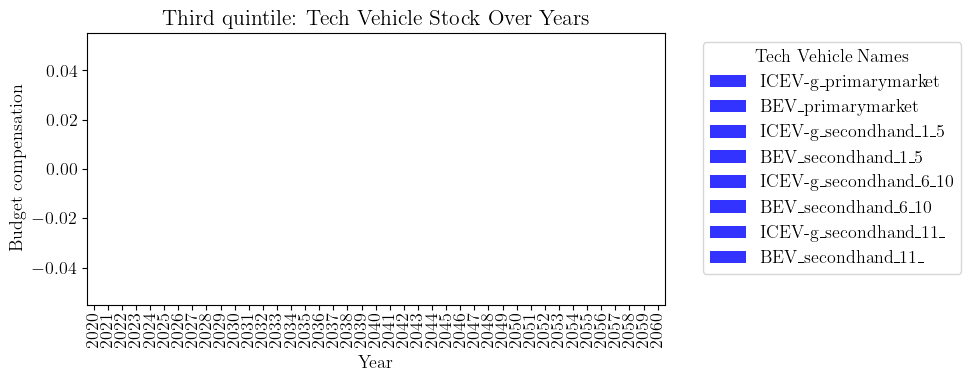

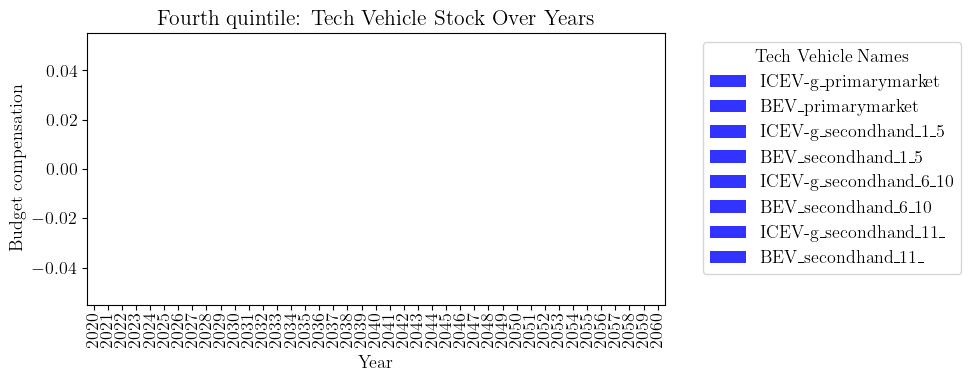

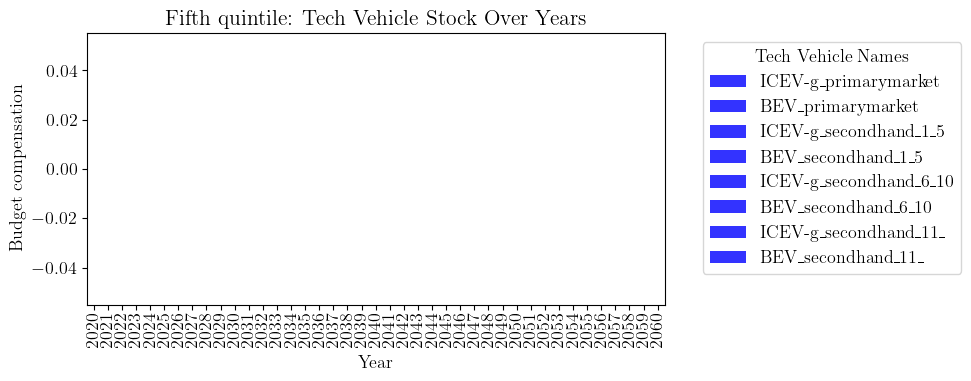

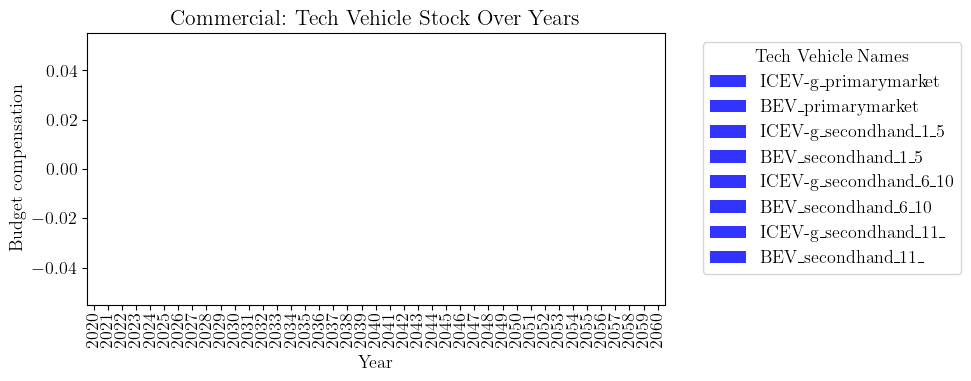

In [315]:
# looking a budget penalties
def get_budget_penalty_total(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_total(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


2020 2060


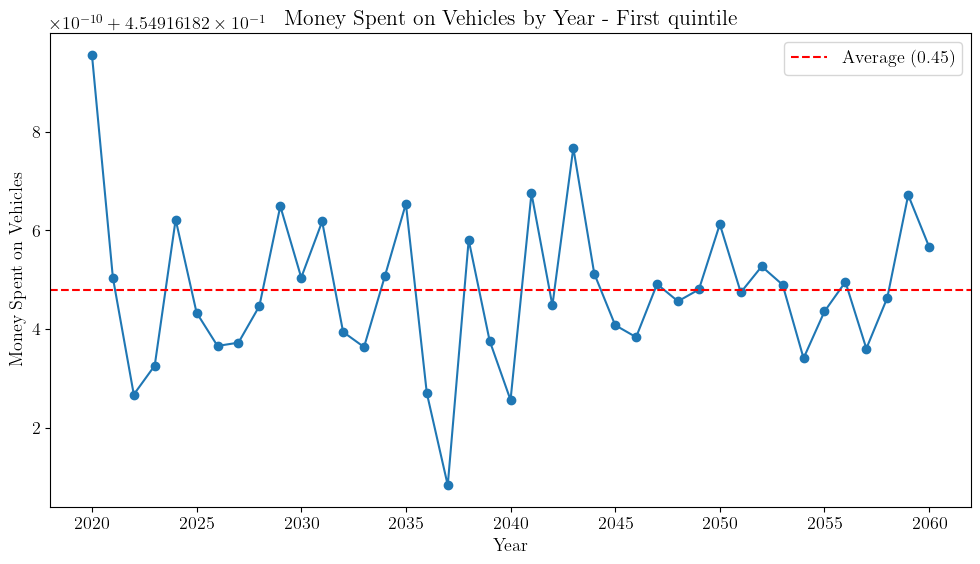

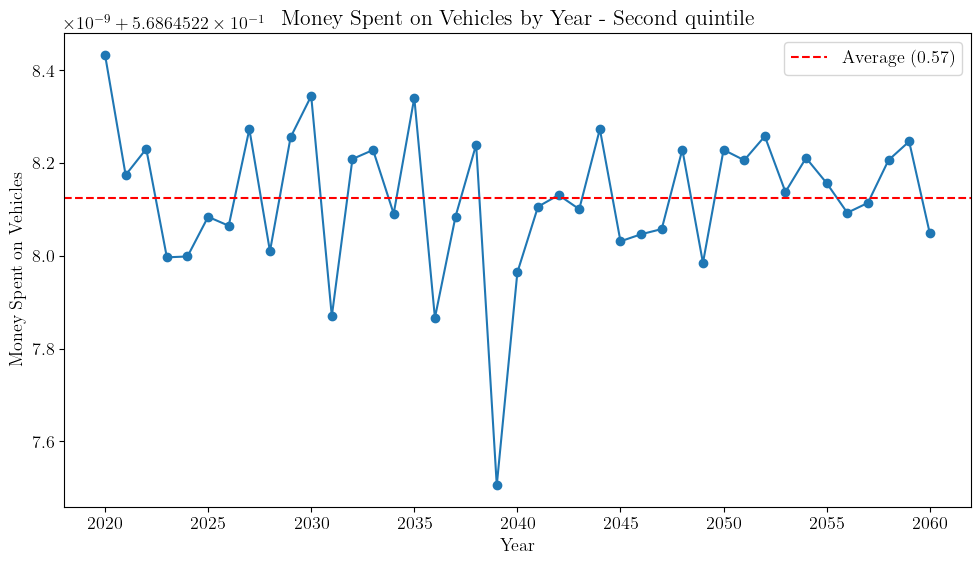

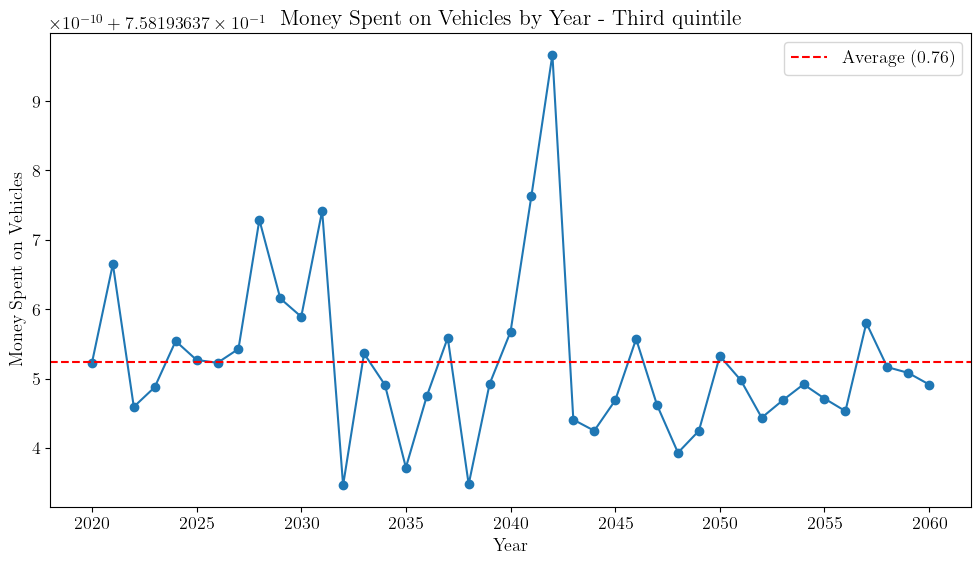

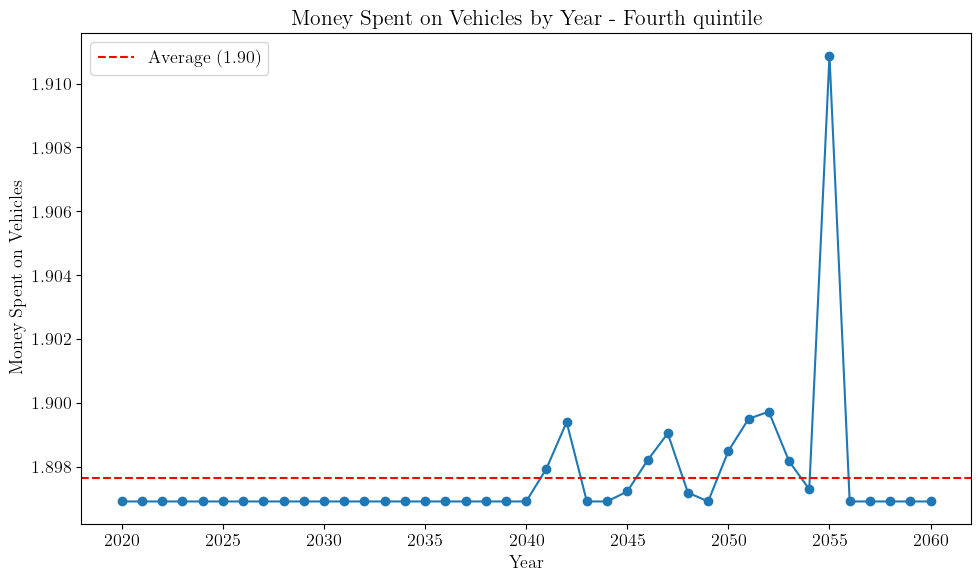

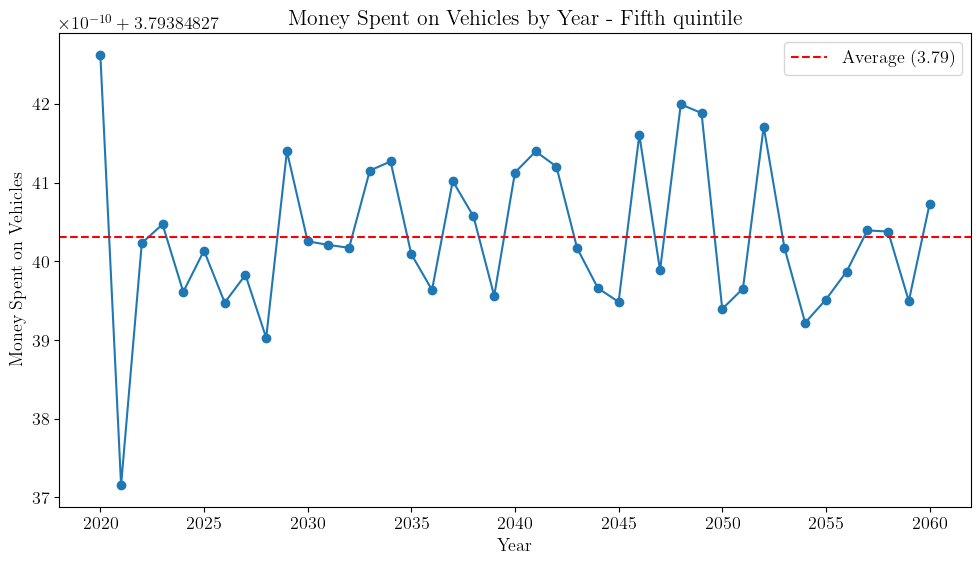

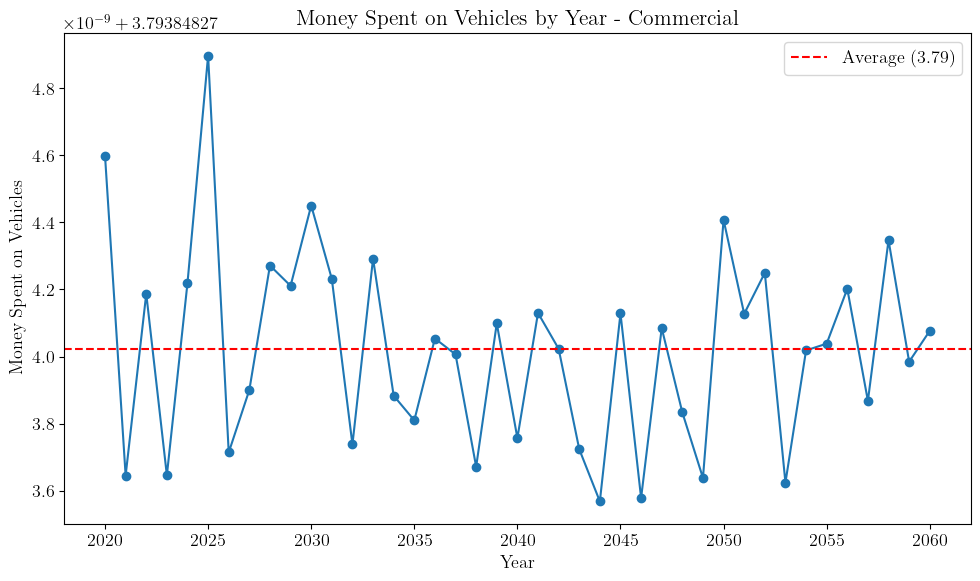

In [316]:
# make a figure with for each fs, how much money was spent on the vehicle?

# purchases by income class
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
techvehicle_list = input_data["TechVehicle"]
techvehicle_list_dict = {item["id"]: item for item in techvehicle_list}
odpair_list = input_data["Odpair"]
odpair_list = {item["id"]: item for item in odpair_list}
money_spent_by_fs = {}
lev_budget_plus = {}
lev_budget_minus = {}
total_budget_plus = {}
total_budget_minus = {}

print(y_init, Y_end)
for fin in financial_status_list.keys():
    
    spent_money = {}
    lev_budget_plus[fin] = {}
    lev_budget_minus[fin] = {}
    income_class = financial_status_list[fin]["name"]

    entire_travel = 0
    for y in range(y_init, Y_end + 1):
        spent_money[y] = 0
        travel_demand_for_fs_y = sum(odpair_list[r]["F"][y - y_init] for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class)
        entire_travel = entire_travel + travel_demand_for_fs_y
        for tv in techvehicle_list_dict.keys():
            costs = techvehicle_list_dict[tv]["capital_cost"]
            bought_vehicles_tot_times_money = sum(h_plus[(y, r, tv, g)]*costs[y-y_init] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r, tv, g) in h.keys())
            spent_money[y] = spent_money[y] + bought_vehicles_tot_times_money
        spent_money[y] = spent_money[y] / travel_demand_for_fs_y
        total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
        total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        lev_budget_plus[fin][y] = total_budget_nb_plus/travel_demand_for_fs_y
        lev_budget_minus[fin][y] = total_budget_nb_minus/travel_demand_for_fs_y
    money_spent_by_fs[fin] = spent_money
    total_budget_plus[fin] = sum(budget_penalty_plus[(y, r)] for y in range(y_init, Y_end + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())/ entire_travel
    total_budget_minus[fin] = sum(budget_penalty_minus[(y, r)] for y in range(y_init, Y_end + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())/ entire_travel


for fin in money_spent_by_fs.keys():
    fin_name = financial_status_list[fin]["name"]
    spent_money = money_spent_by_fs[fin]
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(list(spent_money.keys()), list(spent_money.values()), marker='o')
    avg_spent = np.mean(list(spent_money.values()))
    ax.axhline(avg_spent, color='red', linestyle='--', label=f'Average ({avg_spent:.2f})')
    ax.legend()
    ax.set_xlabel('Year')
    ax.set_ylabel('Money Spent on Vehicles')
    ax.set_title(f'Money Spent on Vehicles by Year - {fin_name}')
    plt.tight_layout()
    plt.show()

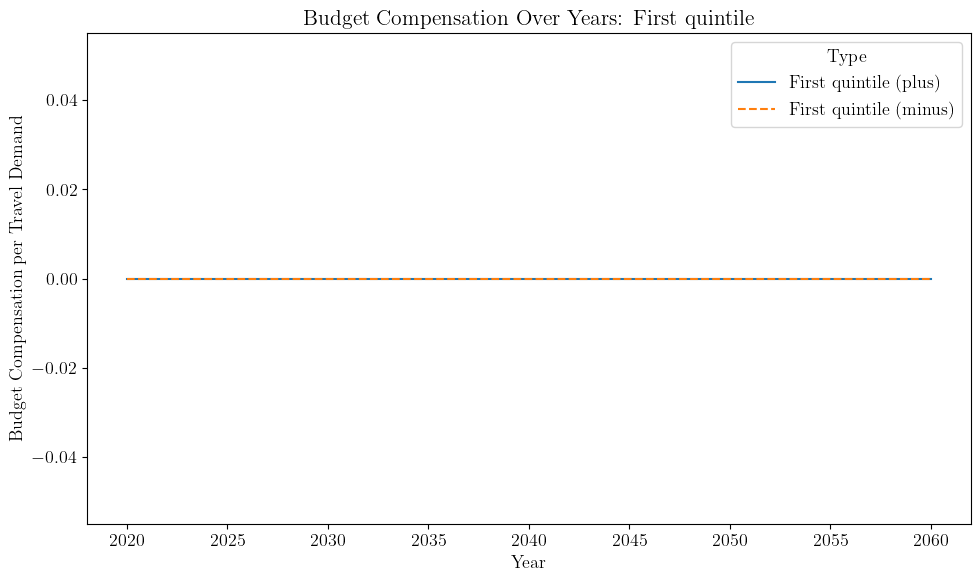

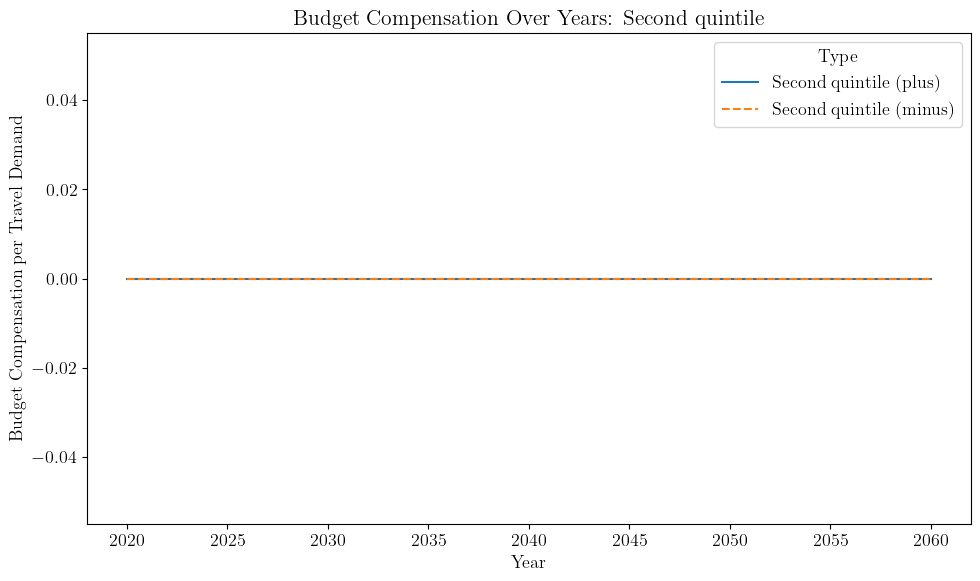

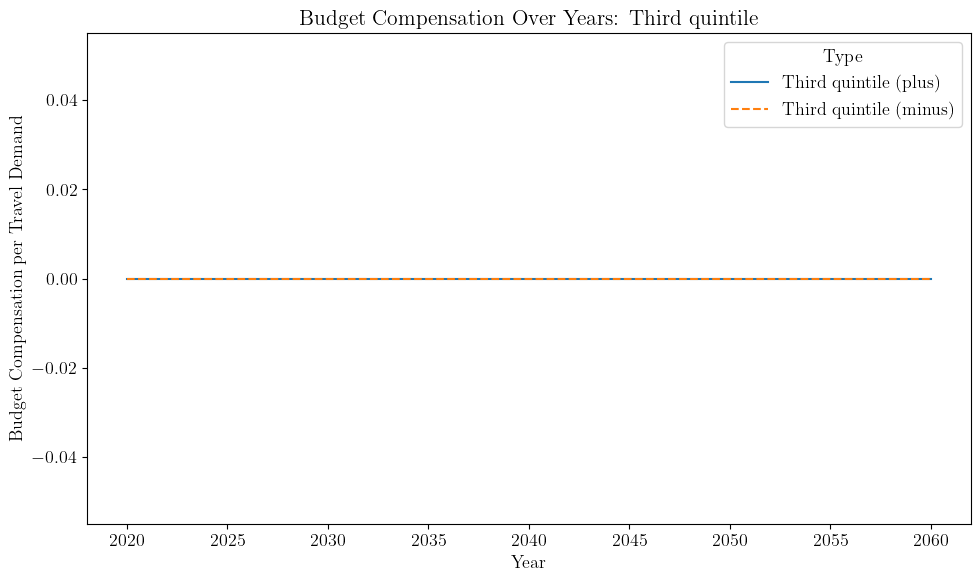

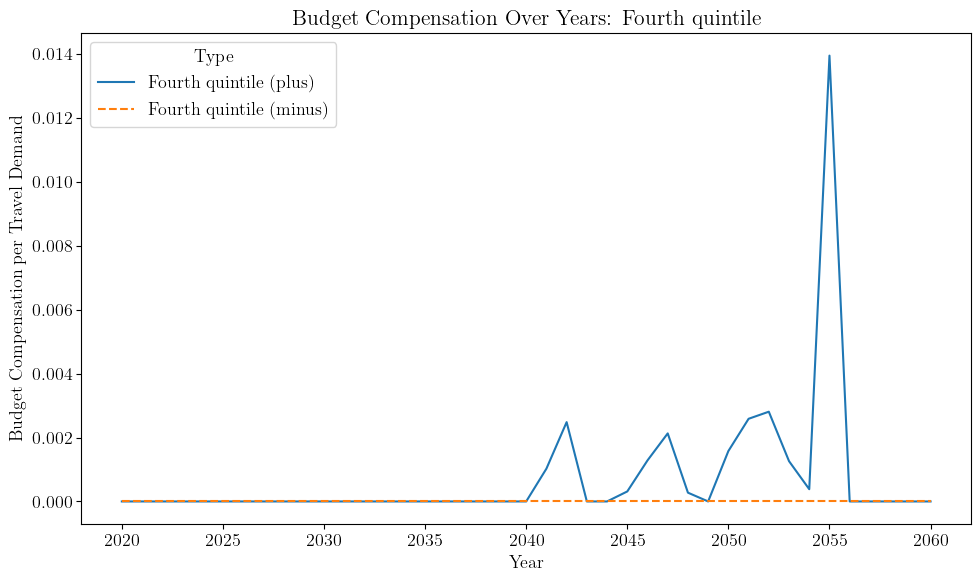

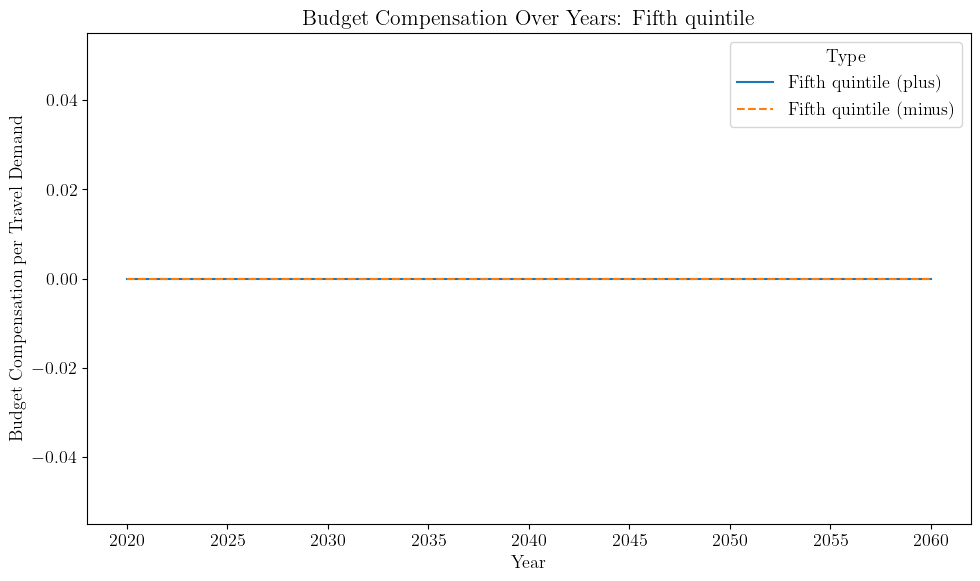

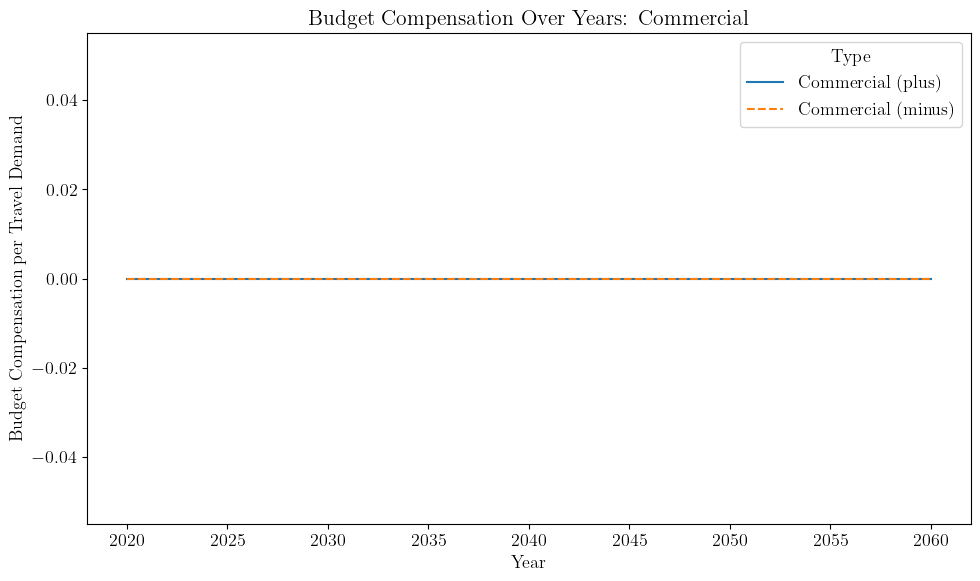

In [317]:
for fin in lev_budget_plus.keys():
    fin_name = financial_status_list[fin]["name"]
    years = sorted(lev_budget_plus[fin].keys())
    plus_values = [lev_budget_plus[fin][y] for y in years]
    minus_values = [lev_budget_minus[fin][y] for y in years]

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(years, plus_values, label=f"{fin_name} (plus)", linestyle='-')
    ax.plot(years, minus_values, label=f"{fin_name} (minus)", linestyle='--')

    ax.set_xlabel('Year')
    ax.set_ylabel('Budget Compensation per Travel Demand')
    ax.set_title(f'Budget Compensation Over Years: {fin_name}')
    ax.legend(title='Type')
    plt.tight_layout()
    plt.show()

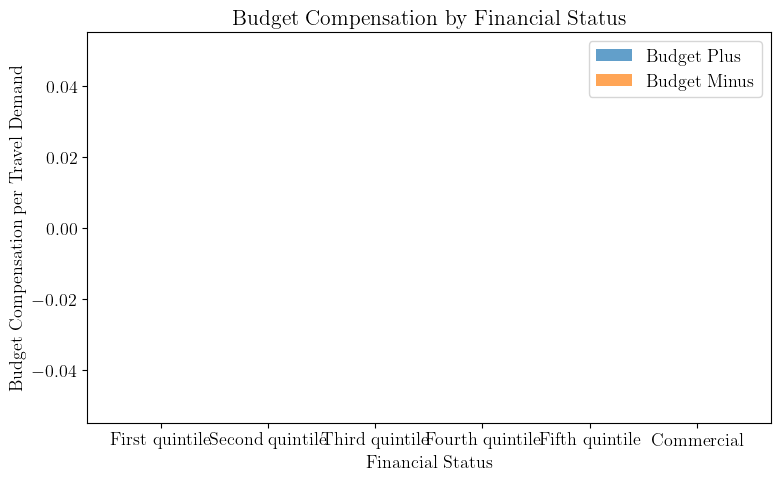

minus {0: 0.0, 1: 0.0, 2: 0.0, 3: 0.0, 4: 0.0, 5: 0.0}
plus {0: 0.0, 1: 0.0, 2: 0.0, 3: 0.0, 4: 0.0, 5: 0.0}


In [318]:
fig, ax = plt.subplots(figsize=(8, 5))

fin_names = [financial_status_list[fin]["name"] for fin in total_budget_plus.keys()]
plus_values = [total_budget_plus[fin] for fin in total_budget_plus.keys()]
minus_values = [total_budget_minus[fin] for fin in total_budget_minus.keys()]

ax.bar(fin_names, plus_values, label='Budget Plus', alpha=0.7)
ax.bar(fin_names, minus_values, label='Budget Minus', alpha=0.7, bottom=plus_values)

ax.set_xlabel('Financial Status')
ax.set_ylabel('Budget Compensation per Travel Demand')
ax.set_title('Budget Compensation by Financial Status')
ax.legend()
plt.tight_layout()
plt.show()
print("minus", total_budget_minus)
print("plus", total_budget_plus)

{(2058, 26): 0.0, (2041, 64): 0.0, (2032, 20): 0.0, (2046, 21): 0.0, (2059, 36): 0.0, (2048, 43): 0.0, (2031, 57): 0.0, (2036, 13): 0.0, (2051, 58): 0.0, (2046, 13): 0.0, (2044, 57): 0.0, (2024, 26): 0.0, (2039, 23): 0.0, (2056, 33): 0.0, (2059, 1): 0.0, (2058, 53): 0.0, (2039, 43): 0.0, (2046, 46): 0.0, (2030, 37): 0.0, (2049, 29): 0.0, (2046, 53): 0.0, (2025, 70): 0.0, (2031, 73): 0.0, (2052, 5): 0.0, (2042, 18): 0.0, (2022, 6): 0.0, (2045, 40): 0.0, (2060, 44): 0.0, (2046, 64): 0.0, (2025, 20): 0.0, (2053, 63): 0.0, (2058, 52): 0.0, (2028, 17): 0.0, (2030, 36): 0.0, (2029, 15): 0.0, (2041, 65): 0.0, (2043, 51): 0.0, (2021, 52): 0.0, (2041, 38): 0.0, (2028, 37): 0.0, (2029, 60): 0.0, (2047, 60): 0.0, (2036, 69): 0.0, (2039, 73): 0.0, (2034, 30): 0.0, (2030, 15): 0.0, (2027, 30): 0.0, (2032, 35): 0.0, (2054, 68): 0.0, (2048, 37): 0.0, (2031, 30): 0.0, (2037, 69): 0.0, (2053, 37): 0.0, (2025, 33): 0.0, (2030, 39): 0.0, (2024, 35): 0.0, (2032, 63): 0.0, (2021, 69): 0.0, (2020, 0): 0.0, 

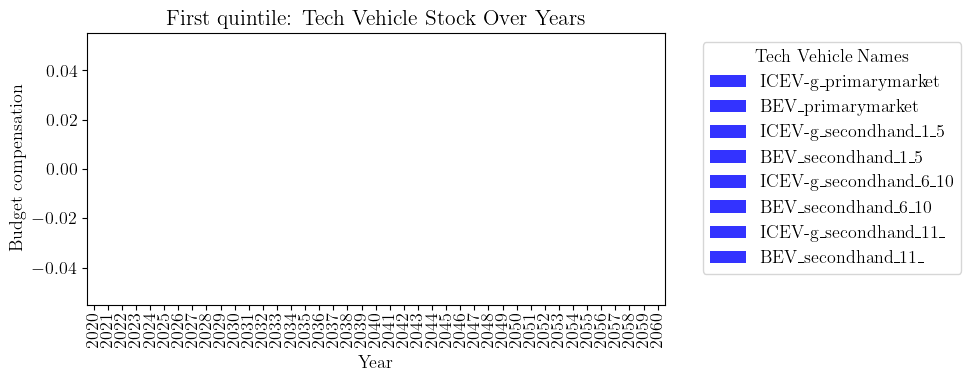

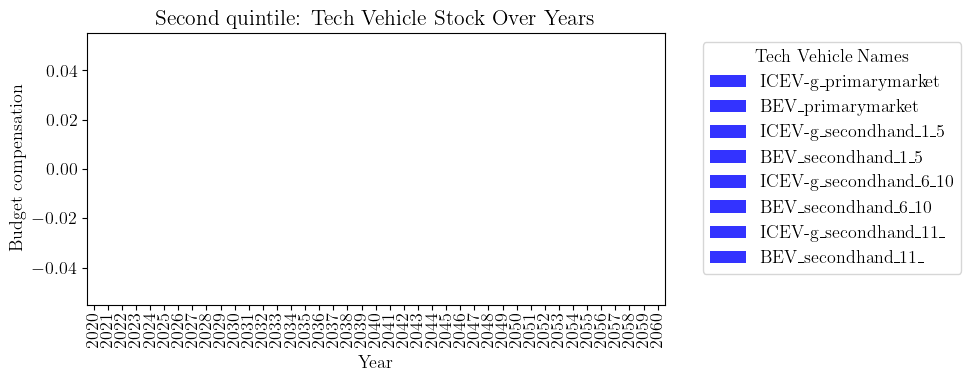

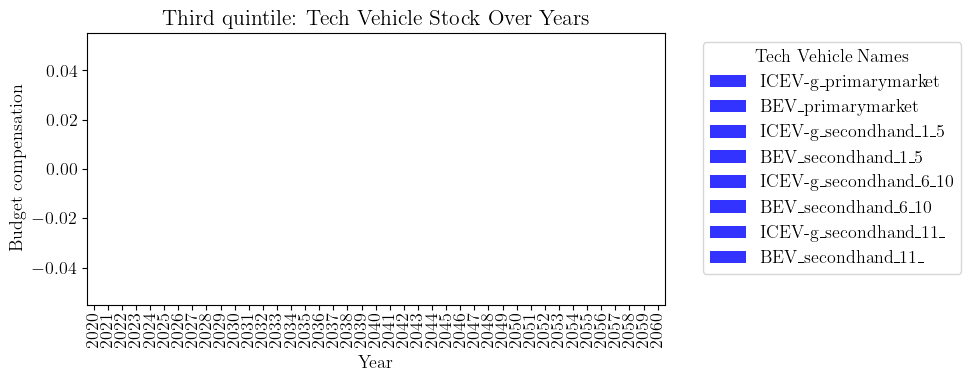

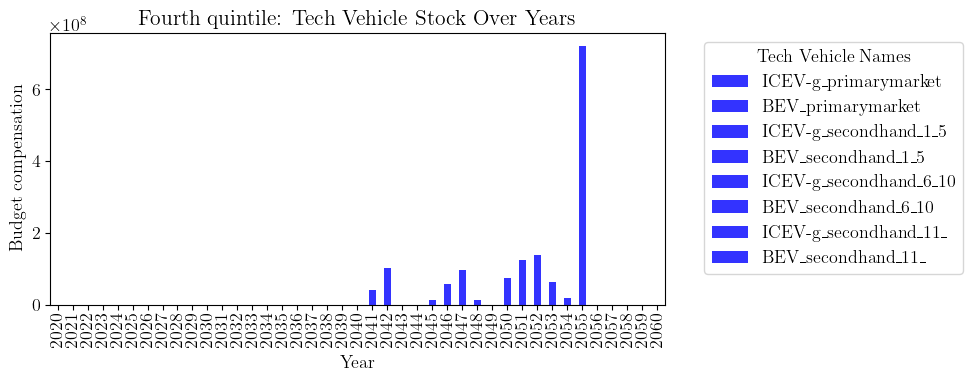

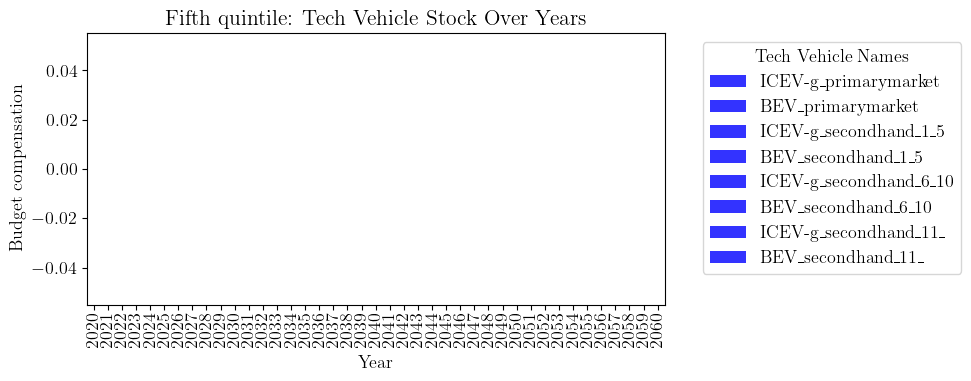

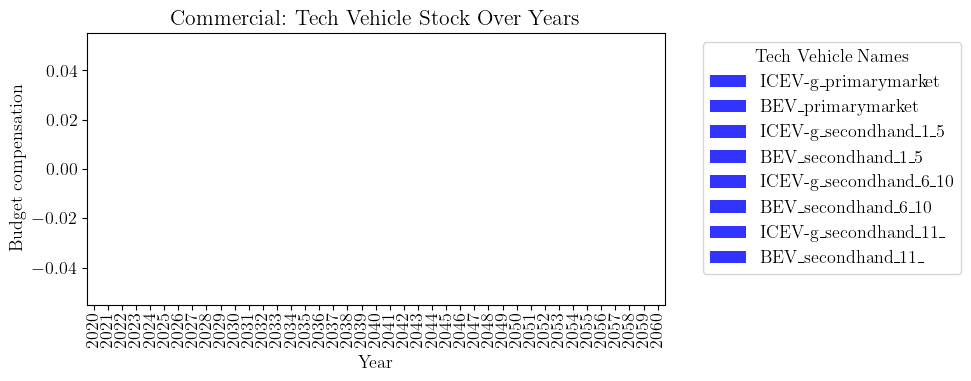

In [319]:
# looking a budget penalties
def get_budget_penalty_yearly(by_income_class = False, income_class=None):
    budget_pen = {}

    # for tv_id in techvehicle_list:

    for y in range(y_init, Y_end + 1):
        if not by_income_class:
            total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if (y, r) in budget_penalty_minus.keys())
        else:
            total_budget_nb_plus = sum(budget_penalty_plus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_plus.keys())
            total_budget_nb_minus = sum(budget_penalty_minus_yearly[(y, r)] for g in range(g_init, y + 1) for r in odpair_list.keys() if odpair_list[r]["financial_status"] == income_class and (y, r) in budget_penalty_minus.keys())
        budget_pen[(y)] = total_budget_nb_plus + total_budget_nb_minus
    return budget_pen

financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
techvehicle_list = input_data["TechVehicle"]
techvehicle_list = {item["id"]: item for item in techvehicle_list}
for fin in financial_status_list.keys():
    tech_vehicle_names = [techvehicle_list[tech_id]["name"] for tech_id in techvehicle_list.keys()]
    fig, ax = plt.subplots(figsize=(10, 4))

    years = range(y_init, Y_end + 1)
    tech_ids = list(techvehicle_list.keys())

    techveh_stock_all = get_budget_penalty_yearly(by_income_class=True, income_class=financial_status_list[fin]["name"])

    # Prepare data for stacked bar plot
    
    data = {year: [techveh_stock_all.get((year))]for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    bars = df.plot(kind='bar', stacked=True, ax=ax, color="blue", alpha=0.8)
    ax.set_xlabel('Year')
    ax.set_ylabel('Budget compensation')
    ax.set_title(financial_status_list[fin]["name"]+ ': Tech Vehicle Stock Over Years')
    handles, _ = ax.get_legend_handles_labels()
    ax.legend(handles, tech_vehicle_names, title='Tech Vehicle Names', bbox_to_anchor=(1.05, 1), loc='upper left')

    plt.tight_layout()
    plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_tech_vehicle_stock_" + financial_status_list[fin]["name"] + ".png"), transparent=True)
print(budget_penalty_plus)


## Fueling infrastructure investments

In [320]:
technology_list = input_data["Technology"]
technology_list = {item["id"]: item for item in technology_list}
geographic_element_list = input_data["GeographicElement"]
geographic_element_list = {item["id"]: item for item in geographic_element_list}
fuel_infr_type_list = input_data["FuelingInfrTypes"]
fuel_infr_type_list = {item["id"]: item for item in fuel_infr_type_list}
fuel_list = input_data["Fuel"]
fuel_list = {item["id"]: item for item in fuel_list}

def get_fuel_infr_plus(by_geographic_element = False, geographic_element=[]):
    q_plus_by_tech = {}


    
    for f in fuel_list.keys():
        for l in fuel_infr_type_list.keys():
            if fuel_infr_type_list[l]["fuel"] == fuel_list[f]["name"]:
                if not by_geographic_element:
                    geographic_element = geographic_element_list.keys()
                    for e in geographic_element:
                        for y in range(y_init, Y_end + 1):
                            if not fuel_infr_type_list[l]["fueling_type"] == "home":
                                total_expansion_per_y = sum(q_fuel_infr_plus[(y0, (f, l), e)] for y0 in range(y_init, y+1) if (y0, (f, l), e) in q_fuel_infr_plus.keys())
                                q_plus_by_tech[(y, (f, l), e)] = total_expansion_per_y
                            else: 
                                total_expansion_per_y = sum(q_fuel_infr_plus_by_route[(y0, r, (f, l), e)] for r in odpair_list.keys() for y0 in range(y_init, y+1) if (y0, r, (f, l), e) in q_fuel_infr_plus_by_route.keys())
                                q_plus_by_tech[(y, (f, l), e)] = total_expansion_per_y
                else:
                    for y in range(y_init, Y_end + 1):
                        if not fuel_infr_type_list[l]["fueling_type"] == "home":
                            total_expansion_per_y = sum(q_fuel_infr_plus[(y0, (f, l), e)] for y0 in range(y_init, y+1) for e in geographic_element if (y0, (f, l), e) in q_fuel_infr_plus.keys())
                            q_plus_by_tech[(y, (f,l))] = total_expansion_per_y
                        else:
                            total_expansion_per_y = sum(q_fuel_infr_plus_by_route[(y0, r, (f, l), e)] for e in geographic_element for r in odpair_list.keys() for y0 in range(y_init, y+1) if (y0, r, (f, l), e) in q_fuel_infr_plus_by_route.keys())
                            q_plus_by_tech[(y, (f, l))] = total_expansion_per_y
            
    return q_plus_by_tech

In [321]:
q_plus_by_tech = get_fuel_infr_plus()

print(sum(q_plus_by_tech.values()))
print(sum(q_fuel_infr_plus.values()))
print(q_plus_by_tech)
print(q_fuel_infr_plus)

84964026.251534
2114575.544034
{(2020, (1, 4), 1): 1867157.991341, (2021, (1, 4), 1): 1867157.991341, (2022, (1, 4), 1): 1867157.991341, (2023, (1, 4), 1): 1867157.991341, (2024, (1, 4), 1): 1867157.991341, (2025, (1, 4), 1): 1867157.991341, (2026, (1, 4), 1): 1867157.991341, (2027, (1, 4), 1): 1867157.991341, (2028, (1, 4), 1): 1867157.991341, (2029, (1, 4), 1): 1867157.991341, (2030, (1, 4), 1): 1867157.991341, (2031, (1, 4), 1): 1867157.991341, (2032, (1, 4), 1): 1867157.991341, (2033, (1, 4), 1): 1867157.991341, (2034, (1, 4), 1): 1867157.991341, (2035, (1, 4), 1): 1867157.991341, (2036, (1, 4), 1): 1867157.991341, (2037, (1, 4), 1): 1867157.991341, (2038, (1, 4), 1): 1867157.991341, (2039, (1, 4), 1): 1867157.991341, (2040, (1, 4), 1): 1867157.991341, (2041, (1, 4), 1): 1867157.991341, (2042, (1, 4), 1): 1867157.991341, (2043, (1, 4), 1): 1867157.991341, (2044, (1, 4), 1): 1867157.991341, (2045, (1, 4), 1): 1867157.991341, (2046, (1, 4), 1): 1867157.991341, (2047, (1, 4), 1): 1867

In [322]:
print(sum(q_fuel_infr_plus_by_route.values()))

0.0


In [323]:
print(9275551 - 27276 + 50007 + 77284 + 90923 + 90923 + 1372270)

10929682


{2020: [0.0, 39364.0, 0.0, 1000.0, 0], 2021: [0.0, 39364.0, 0.0, 1000.0, 0], 2022: [0.0, 39364.0, 0.0, 1000.0, 0], 2023: [0.0, 39364.0, 0.0, 1000.0, 0], 2024: [0.0, 39364.0, 0.0, 1000.0, 0], 2025: [0.0, 39364.0, 30500.0, 61000.0, 0], 2026: [0.0, 39364.0, 30500.0, 61000.0, 0], 2027: [0.0, 39364.0, 30500.0, 61000.0, 0], 2028: [0.0, 39364.0, 30500.0, 61000.0, 0], 2029: [0.0, 39364.0, 30500.0, 61000.0, 0], 2030: [0.0, 39364.0, 65500.0, 131000.0, 0], 2031: [0.0, 39364.0, 65500.0, 131000.0, 0], 2032: [0.0, 39364.0, 65500.0, 131000.0, 0], 2033: [0.0, 39364.0, 65500.0, 131000.0, 0], 2034: [0.0, 39364.0, 65500.0, 131000.0, 0], 2035: [0.0, 39364.0, 65500.0, 131000.0, 0], 2036: [0.0, 39364.0, 65500.0, 131000.0, 0], 2037: [0.0, 39364.0, 65500.0, 131000.0, 0], 2038: [0.0, 39364.0, 65500.0, 131000.0, 0], 2039: [0.0, 39364.0, 65500.0, 131000.0, 0], 2040: [0.0, 39364.0, 69351.184231, 138702.368462, 0], 2041: [0.0, 39364.0, 69351.184231, 138702.368462, 0], 2042: [0.0, 39364.0, 69351.184231, 138702.3684

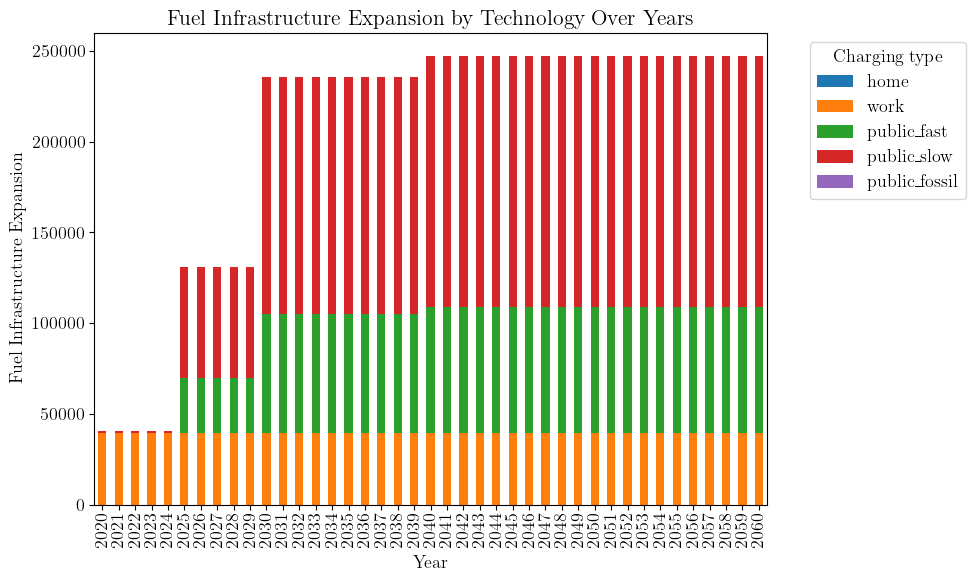

In [324]:
elems_of_interest = [12, 13, 14]

q_plus_by_tech = get_fuel_infr_plus()
# total charging infrastructure 
fuel = "electricity"
f_id = 2
fig, ax = plt.subplots(figsize=(10, 6))

years = range(y_init, Y_end + 1)
tech_ids = list(technology_list.keys())
fuel_type_ids = list(fuel_infr_type_list.keys())
# Prepare data for stacked bar plot
data = {year: [sum([q_plus_by_tech.get((year, (f_id, l), geo)) for geo in geographic_element_list if (year, (f_id, l), geo) in q_plus_by_tech.keys()]) for l in fuel_type_ids] for year in years}
print(data, len(fuel_type_ids), len(tech_ids))
df = pd.DataFrame(data, index=fuel_type_ids).T
print(df)
# Plotting
df.plot(kind='bar', stacked=True, ax=ax)

# Set x and y labels
ax.set_xlabel('Year')
ax.set_ylabel('Fuel Infrastructure Expansion')
ax.set_title('Fuel Infrastructure Expansion by Technology Over Years')

# Set legend labels to fueling_type names
charging_type_labels = [fuel_infr_type_list[l]["fueling_type"] for l in fuel_type_ids]
plt.legend(title='Charging type', labels=charging_type_labels, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()



KeyError: 12

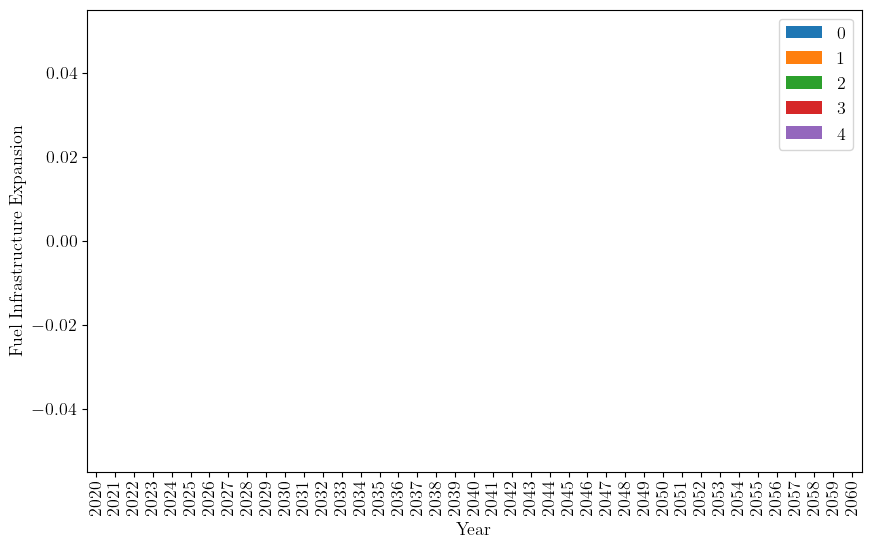

In [325]:
geos_of_interest = [12, 13, 14]
for geo in geos_of_interest:
    fig, ax = plt.subplots(figsize=(10, 6))

    years = range(y_init, Y_end + 1)
    fuel_type_ids
    fuel_type_ids = list(fuel_infr_type_list.keys())
    # Prepare data for stacked bar plot
    f_id = 2
    data = {year: [sum([q_plus_by_tech.get((year, (f_id, l), g)) for g in geographic_element_list if (year, (f_id, l), g) in q_plus_by_tech.keys() and g == geo]) for l in fuel_type_ids] for year in years}
    # print(data)
    df = pd.DataFrame(data, index=fuel_type_ids).T
    # print(df)
    # Plotting
    df.plot(kind='bar', stacked=True, ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('Fuel Infrastructure Expansion')
    ax.set_title('Fuel Infrastructure Expansion by Technology Over Years - ' + geographic_element_list[geo]["name"])
    plt.legend(title='Charging type', bbox_to_anchor=(1.05, 1), loc='upper left', labels=[fuel_infr_type_list[l]["fueling_type"] for l in fuel_type_ids])
    plt.tight_layout()
    plt.show()

In [ ]:
import csv

# Define the years of interest
years_of_interest = range(2020, 2046, 5)

# Initialize a dictionary to store the total sum per region per year
region_sums_per_year = {}

# Iterate through the years of interest
for year in years_of_interest:
    for key, value in q_plus_by_tech.items():
        if key[0] == year and key[1][0] == 2:  # Check if year matches and technology == 2
            region = key[2]  # Extract the region
            if region in [12, 13, 14]:  # Only include regions 12, 13, 14
                if (year, region) not in region_sums_per_year:
                    region_sums_per_year[(year, region)] = 0
                region_sums_per_year[(year, region)] += value

# Save the results to a CSV file
output_file = "q_plus_by_tech_technology_2_per_year.csv"
with open(output_file, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Year", "Region", "Value"])  # Write header
    for (year, region), value in region_sums_per_year.items():
        writer.writerow([year, region, value])

print(f"Results saved to {output_file}")

Results saved to q_plus_by_tech_technology_2_per_year.csv


Plot saved as charging_capacity_per_region.pdf


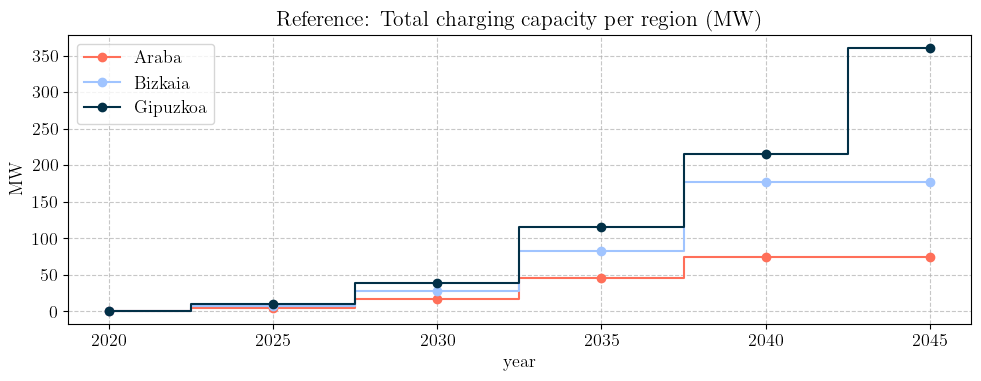

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import io
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "Garamond",
    "font.size": 13,
})
# Convert values from kW to MW
# Data
csv_data = """Year,Region,Value
2020,12,1000.0
2020,13,1000.0
2020,14,1000.0
2025,12,5060.0
2025,13,7505.0
2025,14,9800.0
2030,12,16770.0
2030,13,27772.5
2030,14,38100.0
2035,12,46030.498810000005
2035,13,82446.25
2035,14,115149.99999899999
2040,12,74751.579687
2040,13,176394.621255
2040,14,215365.457766
2045,12,74751.579687
2045,13,176441.245557
2045,14,360824.12834299996
"""
colors = {
    12: "#ff6f59",
    13: "#a0c4ff",
    14: "#023047",
}
correct_names = {
    "ES211": "Araba",
    "ES212": "Bizkaia",
    "ES213": "Gipuzkoa",
}

# Mapping NUTS codes to Basque region names
region_names = {12: 'Araba', 13: 'Bizkaia', 14: 'Gipuzkoa'}

# Load into pandas DataFrame
df = pd.read_csv(io.StringIO(csv_data))
df["Value"] = df["Value"] / 1000.0

# Pivot for plotting
df_pivot = df.pivot(index="Year", columns="Region", values="Value")

# Plot
plt.figure(figsize=(10,4))
for region in df_pivot.columns:
    plt.step(df_pivot.index, df_pivot[region], where="mid", label=region_names.get(region, f"Region {region}"), marker="o", color=colors.get(region, "#000000"))

plt.title("Reference: Total charging capacity per region (MW)")
plt.xlabel("year")
plt.ylabel("MW")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.7)
plt.tight_layout()
output_plot_file = "charging_capacity_per_region.pdf"
plt.savefig(output_plot_file, dpi=300, bbox_inches="tight")
print(f"Plot saved as {output_plot_file}")


In [ ]:
installed_infrastructure_2050 = {}

for l in fuel_infr_type_list.keys():
    total_installed = sum(
        q_fuel_infr_plus[(y, (f_id, l), e)]
        for y in range(y_init, 2051)
        for e in geographic_element_list.keys()
        if (y, (f_id, l), e) in q_fuel_infr_plus
    )
    installed_infrastructure_2050[l] = total_installed

for l in fuel_infr_type_list.keys():
    print(f"{fuel_infr_type_list[l]['fueling_type']}: {installed_infrastructure_2050[l]}")

home: 0
work: 39364.0
public_fast: 128591.701675
public_slow: 257183.403349
public_fossil: 0


In [ ]:
financial_status_list = input_data["FinancialStatus"]
financial_status_list = {item["id"]: item for item in financial_status_list}
od_pair_list = input_data["Odpair"]
od_pair_list = {item["id"]: item for item in od_pair_list}
for fin in financial_status_list.keys():
    fin_name = financial_status_list[fin]["name"]
    s__by_ldict = {}
    for y in range(y_init, Y_end + 1):
        for l in fuel_type_ids:
            total_s = sum(s[(y, (1, r, od_pair_list[r]["path_id"], geo), tv_id, (f_id, l), g)] for f_id in [1, 2] for geo in geographic_element_list.keys() for g in range(g_init, y + 1) for r in od_pair_list.keys() for tv_id in techvehicle_list.keys() if (y, (1, r, od_pair_list[r]["path_id"], geo), tv_id, (f_id, l), g) in s_dict.keys() and odpair_list[r]["financial_status"] == fin_name)
            s__by_ldict[(y, l)] = total_s

    years = range(y_init, Y_end + 1)
    l_ids = list(fuel_type_ids)
    data = {year: [s__by_ldict.get((year, l)) for l in l_ids] for year in years}
    df = pd.DataFrame(data, index=l_ids).T

    fig, ax = plt.subplots(figsize=(10, 6))
    df.plot(kind='bar', stacked=True, ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('s value')
    ax.set_title(f's_dict for {fin_name}')
    ax.legend(title='Fuel Type ID', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

NameError: name 's_dict' is not defined

In [ ]:
# for each geom_item

geometric_element_list = input_data["GeographicElement"]

geometric_element_list = {item["id"]: item for item in geometric_element_list}

for e in geographic_element_list.keys():
    q_plus_by_tech = get_fuel_infr_plus(True, [e])

    fig, ax = plt.subplots(figsize=(10, 6))

    years = range(y_init, Y_end + 1)
    tech_ids = list(technology_list.keys())

    # Prepare data for stacked bar plot
    data = {year: [q_plus_by_tech.get((year, tech_id), 0) for tech_id in tech_ids] for year in years}
    df = pd.DataFrame(data, index=tech_ids).T

    # Plotting
    df.plot(kind='bar', stacked=True, ax=ax)
    ax.set_xlabel('Year')
    ax.set_ylabel('Fuel Infrastructure Expansion')
    ax.set_title(str(geographic_element_list[e]["name"]) + ': Fuel Infrastructure Expansion by Technology Over Years')
    plt.legend(title='Technology ID', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.show()

In [ ]:
# installed cap per e 

geometric_element_list = input_data["GeographicElement"]

geometric_element_list = {item["id"]: item for item in geometric_element_list}
for e in geographic_element_list.keys():
    for fuel in fuel_list.keys():
        total_expansion_per_y = sum(q_fuel_infr_plus[(y, fuel, e)] for y in range(y_init, Y_end+1) if (y, fuel, e) in q_fuel_infr_plus.keys())
        if geographic_element_list[e]["name"] in ["ES213", "ES211", "ES212"]:
            print(geographic_element_list[e]["name"], fuel_list[fuel]["name"], total_expansion_per_y)


In [ ]:
def get_s_per_year_and_tech(tech_id_list = ["diesel", "electricity"]):
    s_per_year_and_tech = {}

    for t in tech_id_list:
        for y in range(y_init, Y_end + 1):
            total_s_per_y = sum(s[(y, (1, r, odpair_list[r]["path_id"], e), tv)] for r in odpair_list.keys() for tv in technology_list.keys() for e in geographic_element_list.keys() if (y, (1, r, odpair_list[r]["path_id"], e), tv) in s.keys() and technology_list[techvehicle_list[tv]["technology"]]["fuel"] in (tech_id_list))
            s_per_year_and_tech[(y, t)] = total_s_per_y
    return s_per_year_and_tech


In [ ]:
energy_fueled_diesel = get_s_per_year_and_tech(tech_id_list=["diesel"])
energy_fueled_electricity = get_s_per_year_and_tech(tech_id_list=["electricity"])
print(energy_fueled_diesel)
print(energy_fueled_electricity)

In [ ]:
# check total investments per technology
data = {year: [q_plus_by_tech.get((year, tech_id), 0) for tech_id in tech_ids if tech_id == 1] for year in years}
print(data)


In [ ]:
# check tech_shift 
technology_list = input_data["Technology"]
technology_list = {item["id"]: item for item in technology_list}
def get_f_per_tech(tech_id_list = ["diesel", "electricity"]):
    f_per_tech_and_year = {}
    for t in tech_id_list:
        for y in range(y_init, Y_end + 1):
            total_activity_per_tech = sum(f[(y, (1, r, odpair_list[r]["path_id"]), (1, tv), g)] for r in odpair_list.keys() for tv in techvehicle_list.keys() for g in range(g_init, y + 1) if (y, (1, r, odpair_list[r]["path_id"]), (1, tv), g) in f.keys() and technology_list[techvehicle_list[tv]["technology"]]["fuel"] in tech_id_list)
            f_per_tech_and_year[(y, t)] = total_activity_per_tech
    return f_per_tech_and_year

In [ ]:
f_per_tech_diesel = get_f_per_tech(tech_id_list=["diesel"])
f_per_tech_electricity = get_f_per_tech(tech_id_list=["electricity"])
print(f_per_tech_diesel)
print(f_per_tech_electricity)



In [ ]:
def get_f_by_mode(mode_list=[1, 2]):
    f_per_mode = {}
    for m in mode_list:
        for y in range(y_init, Y_end + 1):
            total_activity_per_tech = sum(f[(y, (1, r, odpair_list[r]["path_id"]), (m, tv), g)] for r in odpair_list.keys() for tv in range(1, max(techvehicle_list.keys()) + 2) for g in range(g_init, y + 1) if (y, (1, r, odpair_list[r]["path_id"]), (m, tv), g) in f.keys())
            f_per_mode[(y, m)] = total_activity_per_tech
    return f_per_mode

In [ ]:
f_per_mode_1 = get_f_by_mode(mode_list=[1])
f_per_mode_2 = get_f_by_mode(mode_list=[2])
print(f_per_mode_1)
print(f_per_mode_2)

print("f_per_mode_1", sum(f_per_mode_1.values()))
print("f_per_mode_2", sum(f_per_mode_2.values()))

In [ ]:
f_per_tech = get_f_per_tech()
print(f_per_tech)
print(fuel_list)
print(od_pair_list_by_year)
print(technology_list.keys())
for y in range(y_init, Y_end + 1):
    val1 = sum(f_per_tech[(y, fuel_list[f]["name"])] for f in fuel_list.keys())
    val2 = od_pair_list_by_year[y]
    print(f"Year: {y}", val1, val2, val1 - val2, val1 >= val2)




In [ ]:
mode_list = input_data["Mode"]
mode_list = {item["id"]: item for item in mode_list}
product_list = input_data["Product"]
product_list = {item["id"]: item for item in product_list}
vehicle_type_list = input_data["Vehicletype"]
vehicle_type_list = {item["name"]: item for item in vehicle_type_list}
path_list = input_data["Path"]
path_list = {item["id"]: item for item in path_list}

for y in range(y_init, 2022):
    for r in range(1, 4):
        val1 = sum(f[(y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g)] for mode_id in [1, 2] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, 5) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys())
        val2 = odpair_list[r]["F"][y - y_init]
        print(f"Year: {y}, Odpair: {r}", val1, val2, val1 - val2)


## Mode shift

- by trip
- by pkm

In [ ]:
F_sum = 0
mode_list = input_data["Mode"]
mode_list = {item["id"]: item for item in mode_list}
product_list = input_data["Product"]
product_list = {item["id"]: item for item in product_list}
vehicle_type_list = input_data["Vehicletype"]
vehicle_type_list = {item["name"]: item for item in vehicle_type_list}
path_list = input_data["Path"]
path_list = {item["id"]: item for item in path_list}
print(path_list)
activity_per_mode =  {}
financial_status_list = ["Commercial", "First quintile", "Second quintile", "Third quintile", "Fourth quintile", "Fifth quintile"]
# financial_status_list = ["Commercial"]

activity_per_mode_pkm = {}
for mode in mode_list.keys():
    mode_id = mode_list[mode]["id"]
    mode_name = mode_list[mode]["name"]

    for y in range(y_init, Y_end):
        total_activity_per_mode = sum(f[(y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g)] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, len(odpair_list)) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys() and odpair_list[r]["financial_status"] in financial_status_list)
        
        total_activity_per_mode_pkm = sum(f[(y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g)] * path_list[odpair_list[r]["path_id"]]["length"] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, 17) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys() and odpair_list[r]["financial_status"] in financial_status_list)
        if y == 2020:
            F_sum = total_activity_per_mode_pkm + F_sum
        total_pkm = sum(path_list[odpair_list[r]["path_id"]]["length"] for p in product_list.keys() for r in odpair_list.keys() for tv in range(0, 17) for g in range(g_init, y + 1) if (y, (p, r, odpair_list[r]["path_id"]), (mode_id, tv), g) in f.keys() and odpair_list[r]["financial_status"] in financial_status_list)
        activity_per_mode[(y, mode_id)] = total_activity_per_mode
        activity_per_mode_pkm[(y, mode_id)] = total_activity_per_mode_pkm
        print("Year:", y, "Mode:", mode_name, "Activity:", total_activity_per_mode, "Activity pkm:", total_activity_per_mode_pkm, total_pkm)

print("F_sum:", F_sum)


In [ ]:

fig, ax = plt.subplots(figsize=(10, 6))

years = range(y_init, Y_end + 1)
mode_ids = list(set(mode_id for _, mode_id in activity_per_mode.keys()))

# Prepare data for stacked bar plot
data = {year: [activity_per_mode.get((year, mode_id), 0) for mode_id in mode_ids] for year in years}
df = pd.DataFrame(data, index=mode_ids).T

# Plotting
df.plot(kind='bar', stacked=True, ax=ax)
ax.set_xlabel('Year')
ax.set_ylabel('Activity per Mode')
ax.set_title('Activity per Mode Over Years')
plt.legend(title='Mode ID', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()
activity_per_mode


In [ ]:
mode_names = {1: "Road", 2: "Public transport"}

fig, ax = plt.subplots(figsize=(10, 4))

years = range(y_init, Y_end + 1)
mode_ids = list(set(mode_id for _, mode_id in activity_per_mode_pkm.keys()))

# Prepare data for stacked bar plot
data = {year: [activity_per_mode_pkm.get((year, mode_id), 0) for mode_id in mode_ids] for year in years}
df = pd.DataFrame(data, index=mode_ids).T

# Plotting
df.plot(kind='bar', stacked=True, ax=ax, color = ["#432371", "#faae7b"], alpha=0.8, width=0.8)
ax.set_xlabel('Year')
ax.set_ylabel('Transport activity per Mode (pkm)')
ax.set_title('Transport activity per Mode Over Years')
ax.legend(
    labels=[mode_names[mode_id] for mode_id in mode_ids],
    title='Mode shift from road to public transport',
    bbox_to_anchor=(1.05, 1),
    loc='upper left'
)
plt.tight_layout()
plt.savefig(os.path.normpath(file_results + "/" + case_study_name + "_activity_per_mode_pkm.png"), transparent=True)
plt.show()
print(activity_per_mode_pkm[(2020, 1)]/ (1.4 * 14600))
print(activity_per_mode_pkm[(2020, 1)])

In [ ]:
print(mode_list.keys())

In [ ]:
geometric_element_list = input_data["GeographicElement"]

geometric_element_list_by_id = {item["id"]: item for item in geometric_element_list}
geometric_element_list_by_name = {item["name"]: item for item in geometric_element_list}

fuel_list = input_data["Fuel"]
fuel_list_by_id = {item["id"]: item for item in fuel_list}
fuel_list_by_name = {item["name"]: item for item in fuel_list}

# Development of detour time by edge
def get_detour_time_by_edge(by_geom = False, by_fuel = False, geoms = [], fuels = []):
    if by_geom:
        geom_list = geoms
    else:
        geom_list = geometric_element_list_by_name.keys()

    if by_fuel:
        fuels_list = fuels
    else:
        fuels_list = fuel_list.keys()

    detour_time_by_edge = {}
    detour_time_at_place = {}
    for y in range(y_init, Y_end + 1):
        for e in geom_list:
            for fuel in fuels_list:
                tot_veh = 0
                fuel_id = fuel_list_by_name[fuel]["id"]
                for r in odpair_list.keys():
                    # if (y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"]) in detour_time.keys():
                    fueling_vehs = n_fueling[(y, (1, r, odpair_list[r]["path_id"], geometric_element_list_by_name[e]["id"]), fuel_id)]
                        # print(r, fueling_vehs)
                    tot_veh = tot_veh + fueling_vehs
                        # total_detour_time_per_y = sum(detour_time[(y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"])])
                        # detour_time_by_edge[(y, geometric_element_list_by_name[e]["id"], fuel)] = total_detour_time_per_y
                print (y, tot_veh)
                total_detour_time_per_y = sum(detour_time[(y, (p, r, odpair_list[r]["path_id"], geometric_element_list_by_name[e]["id"]), fuel_list_by_name[fuel]["id"])] for r in odpair_list.keys() for p in product_list.keys() if (y, (p, r, odpair_list[r]["path_id"], geometric_element_list_by_name[e]["id"]), fuel_list_by_name[fuel]["id"]) in detour_time.keys())
                if not tot_veh == 0:

                    detour_time_av = total_detour_time_per_y / tot_veh
                else:
                    detour_time_av = 0
                detour_time_by_edge[(y, geometric_element_list_by_name[e]["id"], fuel)] = total_detour_time_per_y
                detour_time_at_place[(y, geometric_element_list_by_name[e]["id"], fuel)] = detour_time_av
    return detour_time_by_edge, detour_time_at_place

In [ ]:
# electricity 
# getting detour time 
detour_time_by_edge, detour_time_at_place = get_detour_time_by_edge(by_geom=True, by_fuel=True, geoms=["ES211"], fuels=["electricity"])

for k in detour_time_at_place.keys():
    print(k, detour_time_at_place[k])
print(detour_time_at_place)

In [ ]:
# diesel
detour_time_by_edge, detour_time_by_place = get_detour_time_by_edge(by_geom=True, by_fuel=True, geoms=["ES211"], fuels=["diesel"])

for k in detour_time_at_place.keys():
    print(k, detour_time_at_place[k])
print(detour_time_at_place)

In [ ]:
geometric_element_list = input_data["GeographicElement"]

geometric_element_list_by_id = {item["id"]: item for item in geometric_element_list}
geometric_element_list_by_name = {item["name"]: item for item in geometric_element_list}

fuel_list = input_data["Fuel"]
fuel_list_by_id = {item["id"]: item for item in fuel_list}
fuel_list_by_name = {item["name"]: item for item in fuel_list}

# Development of detour time by edge
def get_nb_vehs(by_geom = False, by_fuel = False, geoms = [], fuels = []):
    if by_geom:
        geom_list = geoms
    else:
        geom_list = geometric_element_list_by_name.keys()

    if by_fuel:
        fuels_list = fuels
    else:
        fuels_list = fuel_list.keys()

    nb_vehs_fueling = {}
    detour_time_at_place = {}
    for y in range(y_init, Y_end + 1):
        for e in geom_list:
            for fuel in fuels_list:
                tot_veh = 0

                for r in odpair_list.keys():
                    if (y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"]) in detour_time.keys():
                        fueling_vehs = sum(n_fueling[(y, (1, r, odpair_list[r]["path_id"], e), tv)] for tv in techvehicle_list.keys() for e in geographic_element_list.keys() if (y, (1, r, odpair_list[r]["path_id"], e), tv) in n_fueling.keys() and technology_list[techvehicle_list[tv]["technology"]]["fuel"] in fuels_list)
                        # print(r, fueling_vehs)
                        tot_veh = tot_veh + fueling_vehs
                        # total_detour_time_per_y = sum(detour_time[(y, geometric_element_list_by_name[e]["id"], (1, r, odpair_list[r]["path_id"]), fuel_list_by_name[fuel]["id"])])
                        # detour_time_by_edge[(y, geometric_element_list_by_name[e]["id"], fuel)] = total_detour_time_per_y
                print (y, tot_veh)
                
                nb_vehs_fueling[(y, geometric_element_list_by_name[e]["id"], fuel)] = tot_veh
    return nb_vehs_fueling

In [ ]:
nb_vehs_fueling = get_nb_vehs(by_geom=True, by_fuel=True, geoms=["ES211"], fuels=["electricity"])
print(nb_vehs_fueling)